# Baseball Case Study

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import statsmodels.api as sma
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

# load the datasets

In [3]:
df = pd.read_csv('https://raw.githubusercontent.com/dsrscientist/Data-Science-ML-Capstone-Projects/master/baseball.csv')
df


,W,R,AB,H,2B,3B,HR,BB,SO,SB,RA,ER,ERA,CG,SHO,SV,E
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


In [4]:
#display first 10 datasets
df.head(10)

,W,R,AB,H,2B,3B,HR,BB,SO,SB,RA,ER,ERA,CG,SHO,SV,E
0,95,724,5575,1497,300,42,139,383,973,104,641,601,3.73,2,8,56,88
1,83,696,5467,1349,277,44,156,439,1264,70,700,653,4.07,2,12,45,86
2,81,669,5439,1395,303,29,141,533,1157,86,640,584,3.67,11,10,38,79
3,76,622,5533,1381,260,27,136,404,1231,68,701,643,3.98,7,9,37,101
4,74,689,5605,1515,289,49,151,455,1259,83,803,746,4.64,7,12,35,86
5,93,891,5509,1480,308,17,232,570,1151,88,670,609,3.80,7,10,34,88
6,87,764,5567,1397,272,19,212,554,1227,63,698,652,4.03,3,4,48,93
7,81,713,5485,1370,246,20,217,418,1331,44,693,646,4.05,0,10,43,77
8,80,644,5485,1383,278,32,167,436,1310,87,642,604,3.74,1,12,60,95
9,78,748,5640,1495,294,33,161,478,1148,71,753,694,4.31,3,10,40,97


# Exploratory Data Analysis(EDA)

In [5]:
#checking the dimension of the dataset

df.shape

(30, 17)

The dataset contains 30 rows and 17 columns, indicating a small sample size for model building.

In [6]:
#all columns of dataset
df.columns

Index(['W', 'R', 'AB', 'H', '2B', '3B', 'HR', 'BB', 'SO', 'SB', 'RA', 'ER',
       'ERA', 'CG', 'SHO', 'SV', 'E'],
      dtype='object')

In [7]:
#checking the datatypes of column
df.dtypes

W        int64
R        int64
AB       int64
H        int64
2B       int64
3B       int64
HR       int64
BB       int64
SO       int64
SB       int64
RA       int64
ER       int64
ERA    float64
CG       int64
SHO      int64
SV       int64
E        int64
dtype: object

All columns in the dataset are of integer (int64) type except for the ERA column, which is a float (float64).

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 17 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   W       30 non-null     int64  
 1   R       30 non-null     int64  
 2   AB      30 non-null     int64  
 3   H       30 non-null     int64  
 4   2B      30 non-null     int64  
 5   3B      30 non-null     int64  
 6   HR      30 non-null     int64  
 7   BB      30 non-null     int64  
 8   SO      30 non-null     int64  
 9   SB      30 non-null     int64  
 10  RA      30 non-null     int64  
 11  ER      30 non-null     int64  
 12  ERA     30 non-null     float64
 13  CG      30 non-null     int64  
 14  SHO     30 non-null     int64  
 15  SV      30 non-null     int64  
 16  E       30 non-null     int64  
dtypes: float64(1), int64(16)
memory usage: 4.1 KB


The dataset has 30 entries with 17 columns, all of which contain non-null values, with 16 columns being integers and 1 column (ERA) as a float, using 4.1 KB of memory.

In [9]:
#checking the null values
df.isnull().sum()

W      0
R      0
AB     0
H      0
2B     0
3B     0
HR     0
BB     0
SO     0
SB     0
RA     0
ER     0
ERA    0
CG     0
SHO    0
SV     0
E      0
dtype: int64

so as observed from the above data that there are no null values and so don't have to deal with any missing data.

<Axes: >

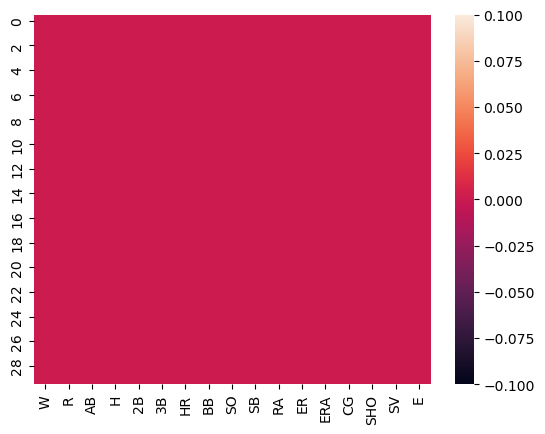

In [10]:
#lets visualise it using heatmap
sns.heatmap(df.isnull())

# Description

In [11]:
df.describe()

,W,R,AB,H,2B,3B,HR,BB,SO,SB,RA,ER,ERA,CG,SHO,SV,E
count,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,80.966667,688.233333,5516.266667,1403.533333,274.733333,31.300000,163.633333,469.100000,1248.20000,83.500000,688.233333,635.833333,3.956333,3.466667,11.300000,43.066667,94.333333
std,10.453455,58.761754,70.467372,57.140923,18.095405,10.452355,31.823309,57.053725,103.75947,22.815225,72.108005,70.140786,0.454089,2.763473,4.120177,7.869335,13.958889
min,63.000000,573.000000,5385.000000,1324.000000,236.000000,13.000000,100.000000,375.000000,973.00000,44.000000,525.000000,478.000000,2.940000,0.000000,4.000000,28.000000,75.000000
25%,74.000000,651.250000,5464.000000,1363.000000,262.250000,23.000000,140.250000,428.250000,1157.50000,69.000000,636.250000,587.250000,3.682500,1.000000,9.000000,37.250000,86.000000
50%,81.000000,689.000000,5510.000000,1382.500000,275.500000,31.000000,158.500000,473.000000,1261.50000,83.500000,695.500000,644.500000,4.025000,3.000000,12.000000,42.000000,91.000000
75%,87.750000,718.250000,5570.000000,1451.500000,288.750000,39.000000,177.000000,501.250000,1311.50000,96.500000,732.500000,679.250000,4.220000,5.750000,13.000000,46.750000,96.750000
max,100.000000,891.000000,5649.000000,1515.000000,308.000000,49.000000,232.000000,570.000000,1518.00000,134.000000,844.000000,799.000000,5.040000,11.000000,21.000000,62.000000,126.000000


The data shows that baseball teams have different levels of performance, with wide variations in wins, runs, and other stats, highlighting differences in team strength and gameplay.

In [12]:
# Count unique values for each column
for column in df.columns:
    print(f"Value counts for {column}:")
    print(df[column].value_counts())
    print("\n")

Value counts for W:
W
68     3
81     2
76     2
74     2
83     2
98     1
84     1
92     1
63     1
67     1
71     1
90     1
64     1
97     1
95     1
100    1
85     1
86     1
88     1
78     1
80     1
87     1
93     1
79     1
Name: count, dtype: int64


Value counts for R:
R
689    2
696    2
724    1
647    1
650    1
720    1
667    1
626    1
573    1
613    1
703    1
683    1
640    1
655    1
697    1
694    1
656    1
661    1
729    1
751    1
748    1
644    1
713    1
764    1
891    1
622    1
669    1
737    1
Name: count, dtype: int64


Value counts for AB:
AB
5485    2
5575    1
5631    1
5457    1
5649    1
5565    1
5385    1
5529    1
5420    1
5463    1
5428    1
5527    1
5571    1
5480    1
5491    1
5484    1
5467    1
5600    1
5544    1
5417    1
5459    1
5511    1
5640    1
5567    1
5509    1
5605    1
5533    1
5439    1
5572    1
Name: count, dtype: int64


Value counts for H:
H
1363    2
1497    1
1386    1
1324    1
1494    1
1486    1
1346    

we observe that most of the columns (like W, R, AB, etc.) represent continuous data, while a few (such as CG, SHO, SV, and E) are more categorical due to repeated values or limited unique values.

In [13]:
for column in df.columns:
    print(f"{column} has {df[column].nunique()} unique values.")


W has 24 unique values.
R has 28 unique values.
AB has 29 unique values.
H has 29 unique values.
2B has 22 unique values.
3B has 23 unique values.
HR has 27 unique values.
BB has 29 unique values.
SO has 29 unique values.
SB has 27 unique values.
RA has 30 unique values.
ER has 30 unique values.
ERA has 30 unique values.
CG has 9 unique values.
SHO has 12 unique values.
SV has 20 unique values.
E has 21 unique values.


from above data to some extent we can differentiate between continuous and categorical data.

In [14]:
df['W'].unique()

array([ 95,  83,  81,  76,  74,  93,  87,  80,  78,  88,  86,  85,  68,
       100,  98,  97,  64,  90,  71,  67,  63,  92,  84,  79], dtype=int64)

In [15]:
df['CG'].unique()

array([ 2, 11,  7,  3,  0,  1,  5,  6,  4], dtype=int64)

In [16]:
df['SHO'].unique()

array([ 8, 12, 10,  9,  4, 13, 15, 21,  7, 14, 18,  6], dtype=int64)

In [17]:
df['SV'].unique()

array([56, 45, 38, 37, 35, 34, 48, 43, 60, 40, 39, 46, 28, 62, 54, 50, 41,
       44, 47, 36], dtype=int64)

In [18]:
df['E'].unique()

array([ 88,  86,  79, 101,  93,  77,  95,  97, 119,  85,  94, 126,  96,
       122, 111, 116,  90, 117,  75,  78,  92], dtype=int64)

# visualisation

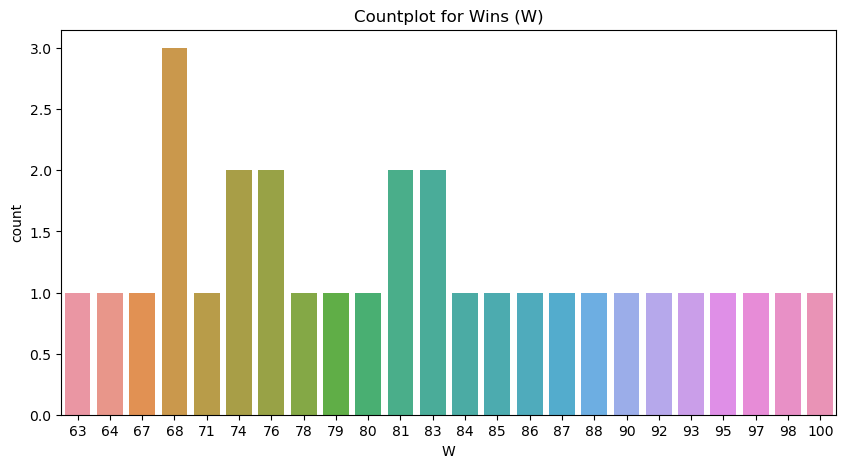

In [19]:
#countplot for the 'W' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['W'])
plt.title('Countplot for Wins (W)')
plt.show()

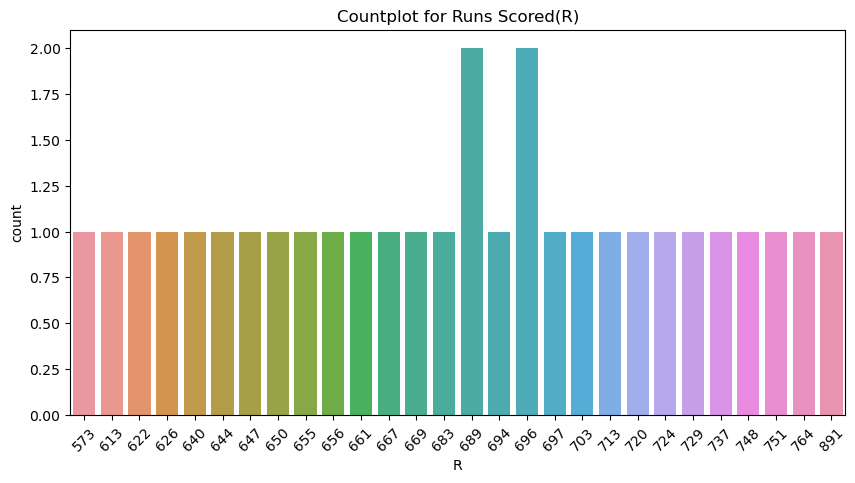

In [20]:
#countplot for the 'R' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['R'])
plt.xticks(rotation=45)
plt.title('Countplot for Runs Scored(R)')
plt.show()

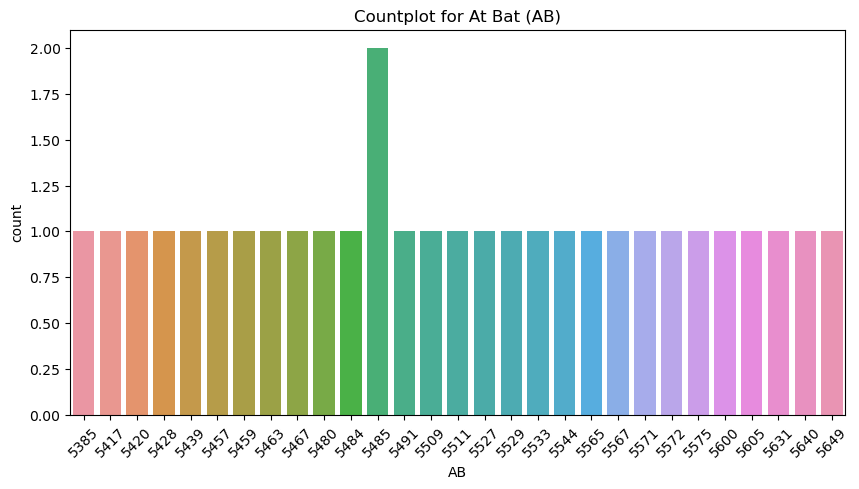

In [21]:
#countplot for the 'AB' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['AB'])
plt.xticks(rotation=45)
plt.title('Countplot for At Bat (AB)')
plt.show()

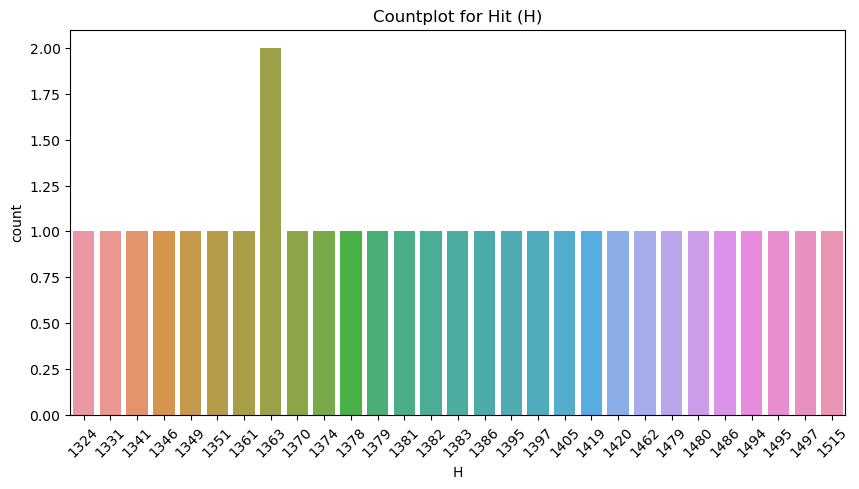

In [22]:
#countplot for the 'H' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['H'])
plt.xticks(rotation=45)
plt.title('Countplot for Hit (H)')
plt.show()

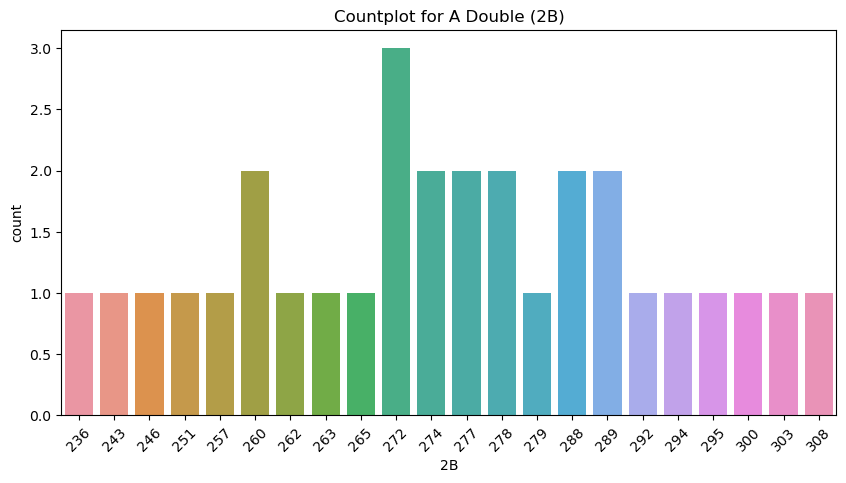

In [23]:
#countplot for the '2B' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['2B'])
plt.xticks(rotation=45)
plt.title('Countplot for A Double (2B)')
plt.show()

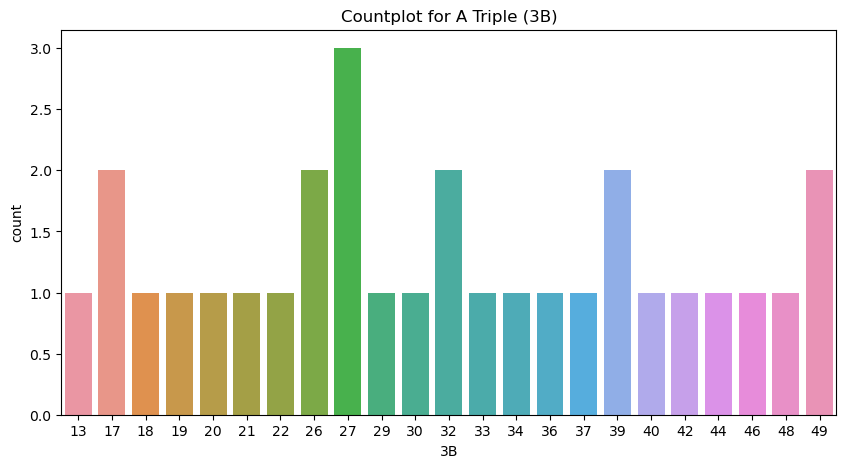

In [24]:
#countplot for the '3B' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['3B'])
plt.title('Countplot for A Triple (3B)')
plt.show()

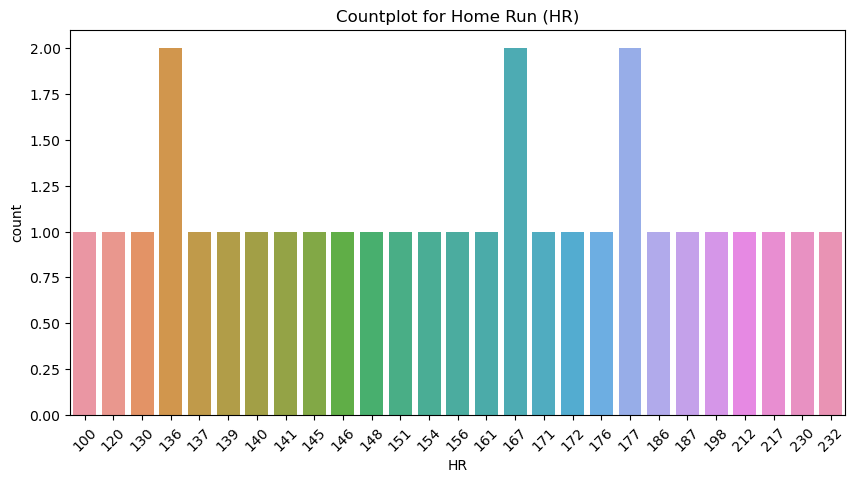

In [25]:
#countplot for the 'HR' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['HR'])
plt.xticks(rotation=45)
plt.title('Countplot for Home Run (HR)')
plt.show()

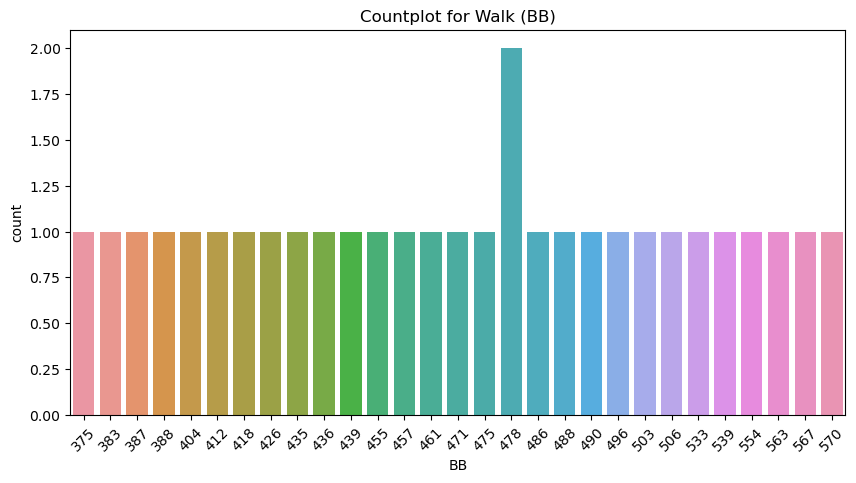

In [26]:
#countplot for the 'BB' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['BB'])
plt.xticks(rotation=45)
plt.title('Countplot for Walk (BB)')
plt.show()

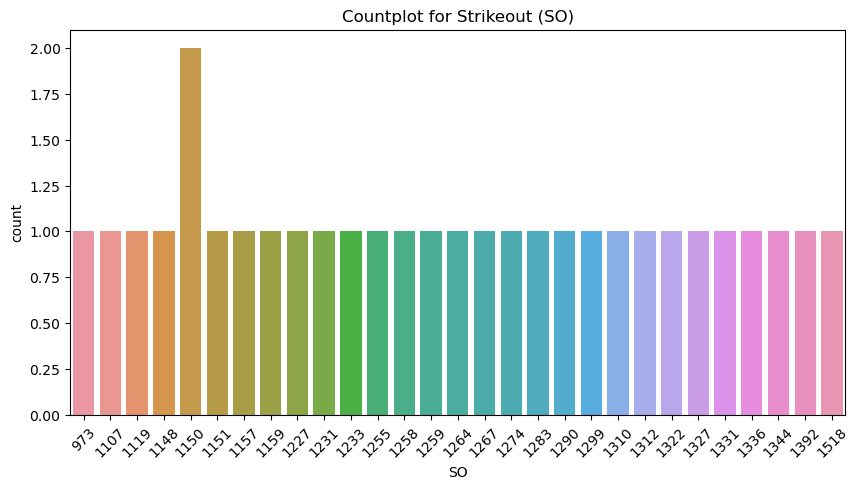

In [27]:
#countplot for the 'SO' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['SO'])
plt.xticks(rotation=45)
plt.title('Countplot for Strikeout (SO)')
plt.show()

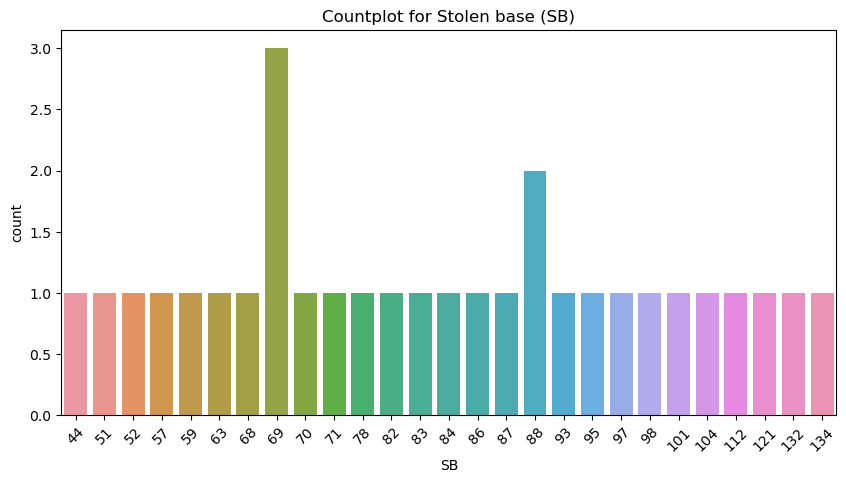

In [28]:
#countplot for the 'SB' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['SB'])
plt.xticks(rotation=45)
plt.title('Countplot for Stolen base (SB)')
plt.show()

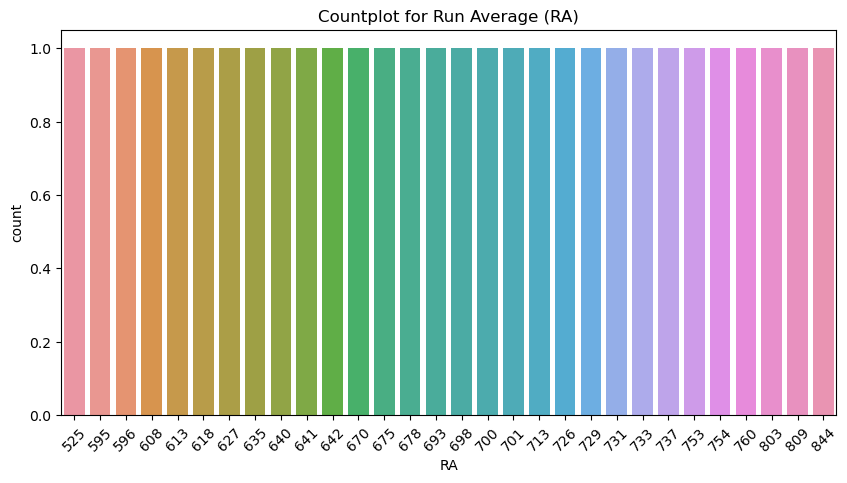

In [29]:
#countplot for the 'RA' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['RA'])
plt.xticks(rotation=45)
plt.title('Countplot for Run Average (RA)')
plt.show()

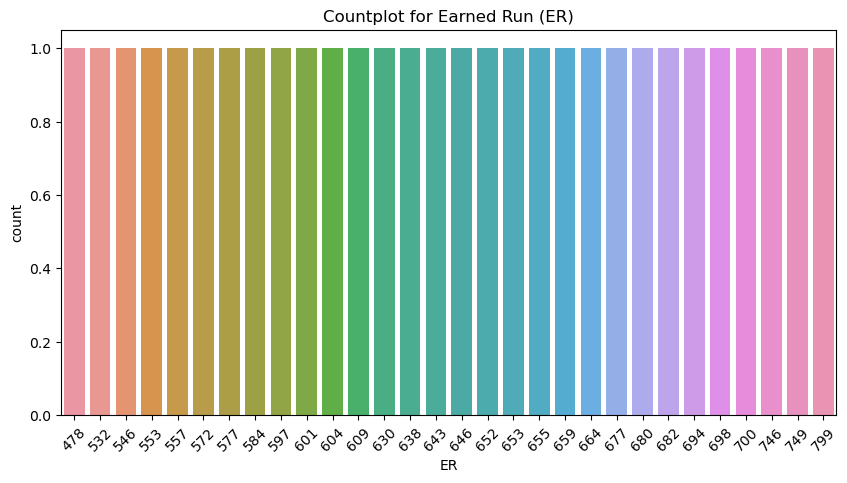

In [30]:
#countplot for the 'ER' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['ER'])
plt.xticks(rotation=45)
plt.title('Countplot for Earned Run (ER)')
plt.show()

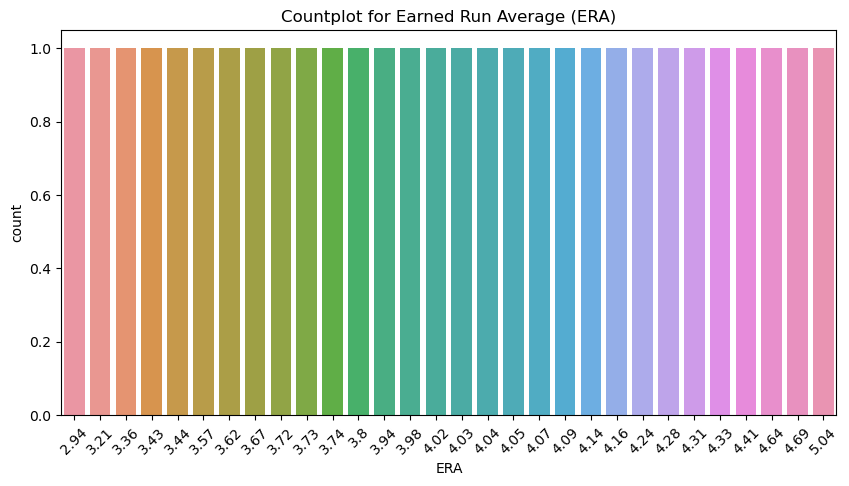

In [31]:
#countplot for the 'ERA' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['ERA'])
plt.xticks(rotation=45)
plt.title('Countplot for Earned Run Average (ERA)')
plt.show()

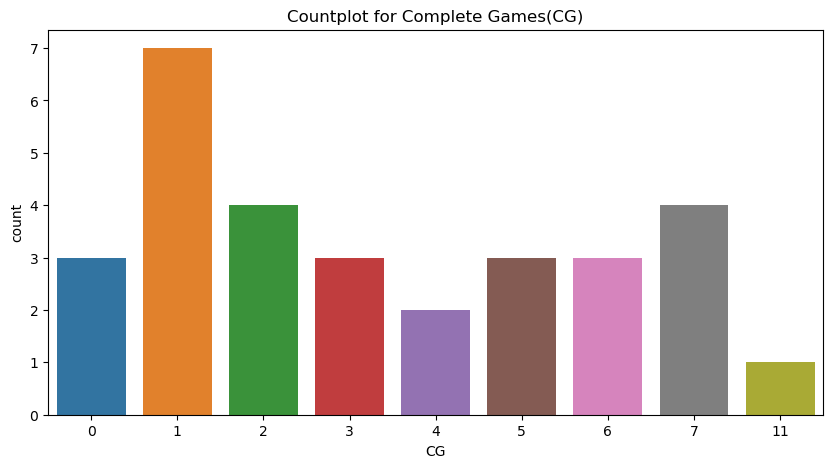

In [32]:
#countplot for the 'CG' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['CG'])
plt.title('Countplot for Complete Games(CG)')
plt.show()

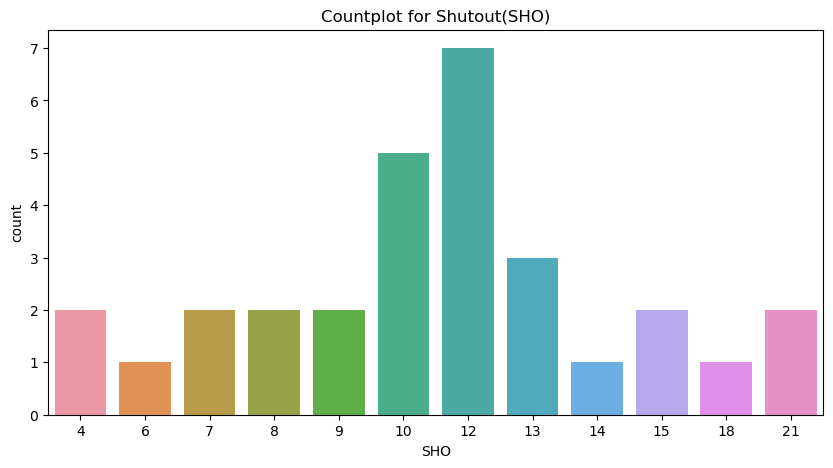

In [33]:
#countplot for the 'SHO' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['SHO'])
plt.title('Countplot for Shutout(SHO)')
plt.show()

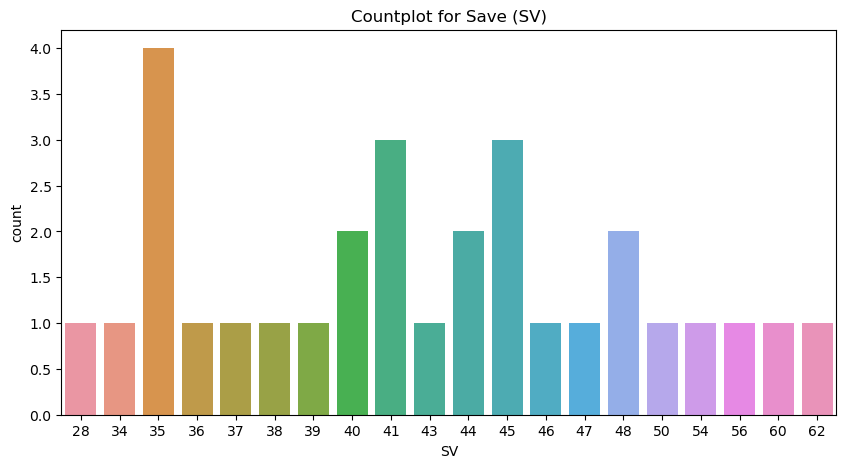

In [34]:
#countplot for the 'SV' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['SV'])
plt.title('Countplot for Save (SV)')
plt.show()

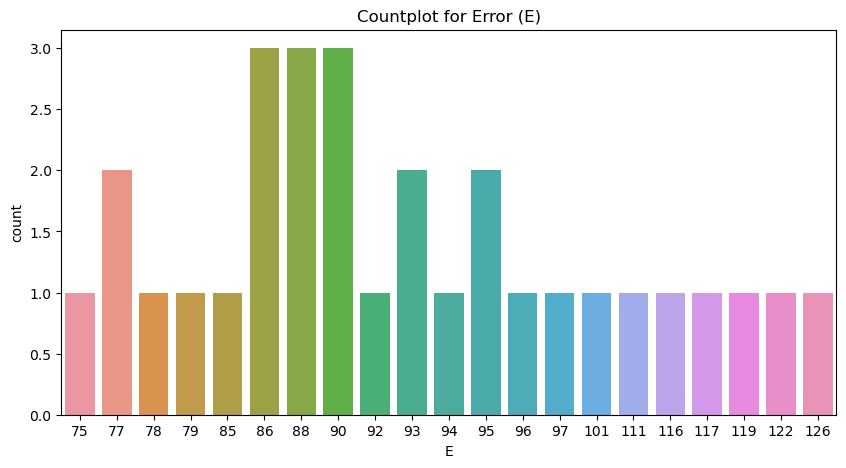

In [35]:
#countplot for the 'E' column
plt.figure(figsize=(10, 5))
sns.countplot(x=df['E'])
plt.title('Countplot for Error (E)')
plt.show()

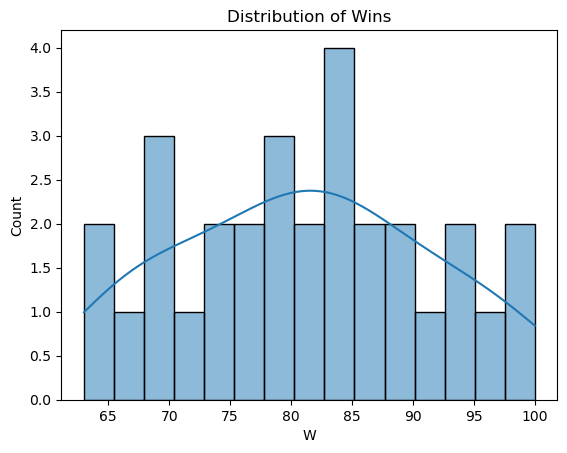

In [36]:
# Visualizing the distribution of the target variable 
sns.histplot(df['W'], bins=15, kde=True)
plt.title('Distribution of Wins')
plt.show()

The distribution of wins (W) appears to be fairly balanced, with a peak around 85 wins and fewer teams achieving both low (65-70) and high (95-100) win totals.

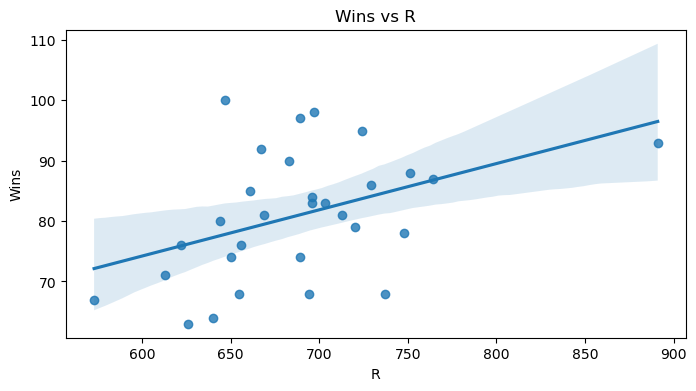

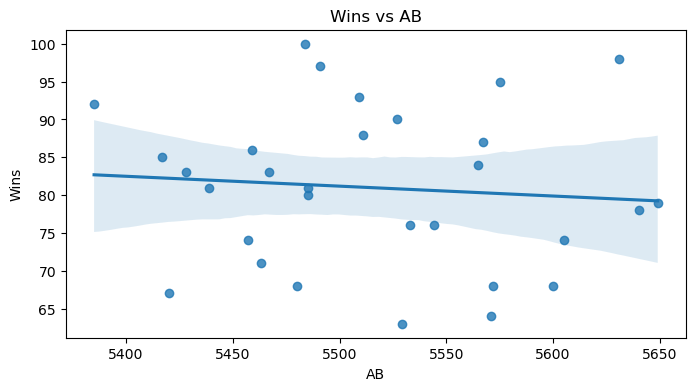

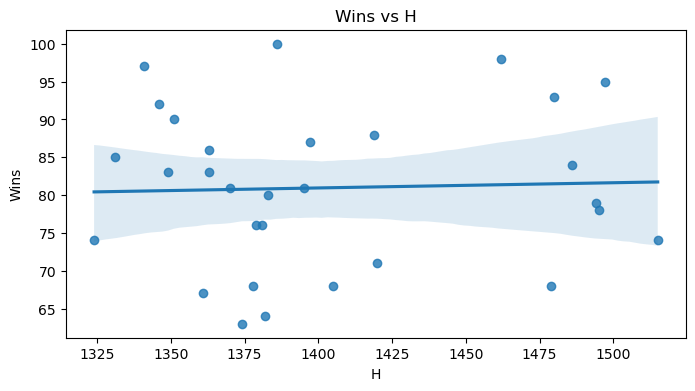

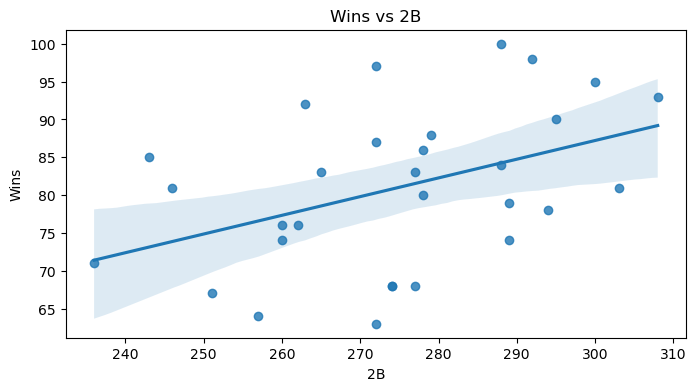

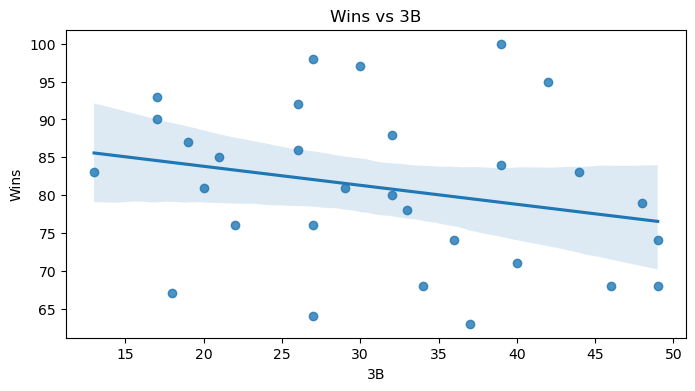

...

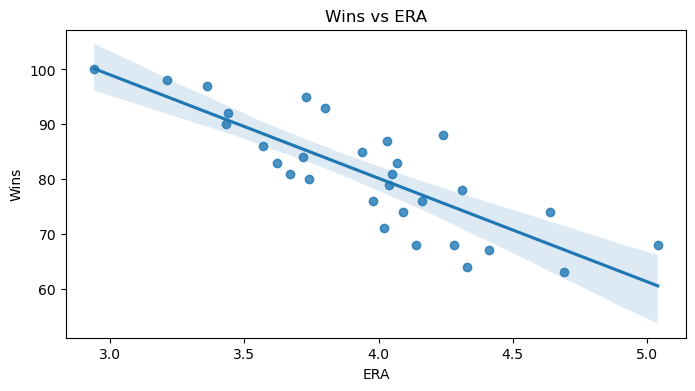

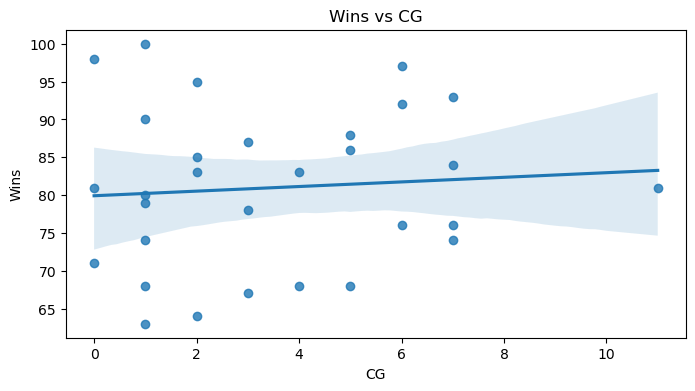

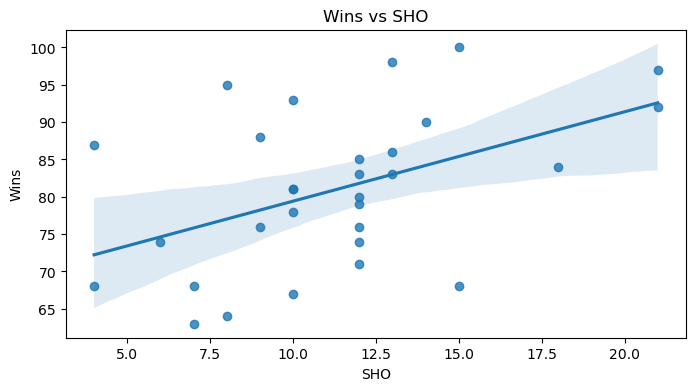

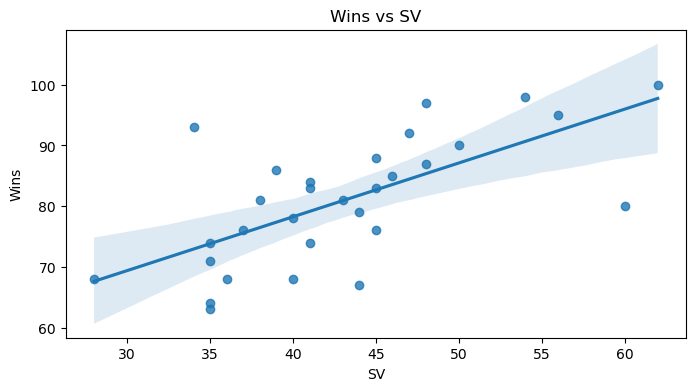

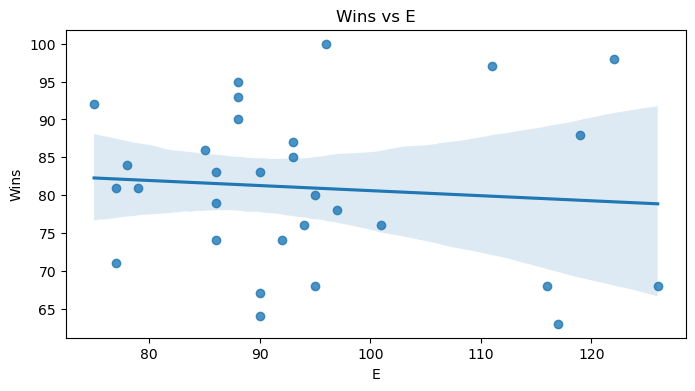

In [37]:
# List of all columns
columns = df.columns[df.columns != 'W']

# Loop through each column and plot
for column in columns:
    plt.figure(figsize=(8, 4))
    sns.regplot(x=df[column], y=df['W'])
    plt.title(f'Wins vs {column}')
    plt.xlabel(column)
    plt.ylabel('Wins')
    plt.show()

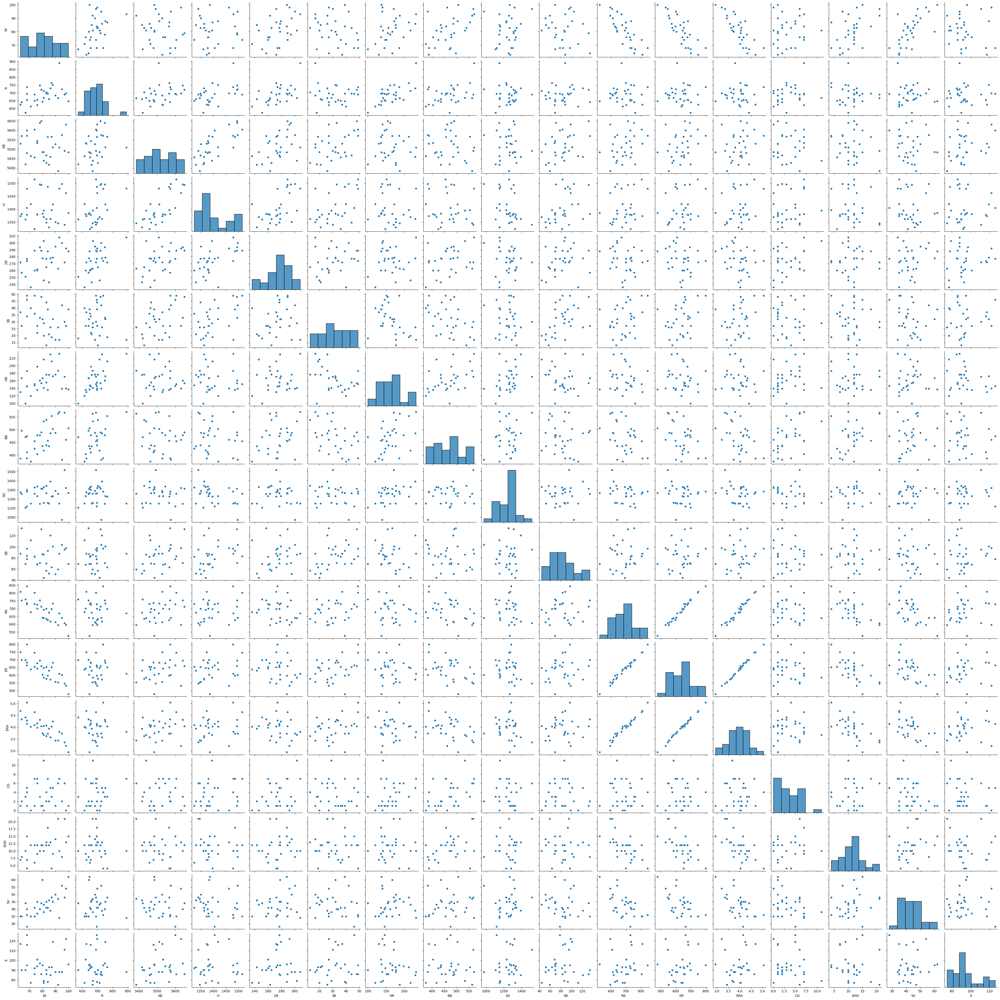

In [38]:
sns.pairplot(df)
plt.show()

>The scatterplot matrix shows that some features are related to each other, while others are not. 

>The diagonal histograms show the distribution of each feature, helping us understand which ones may need adjustments, like fixing any skewed data

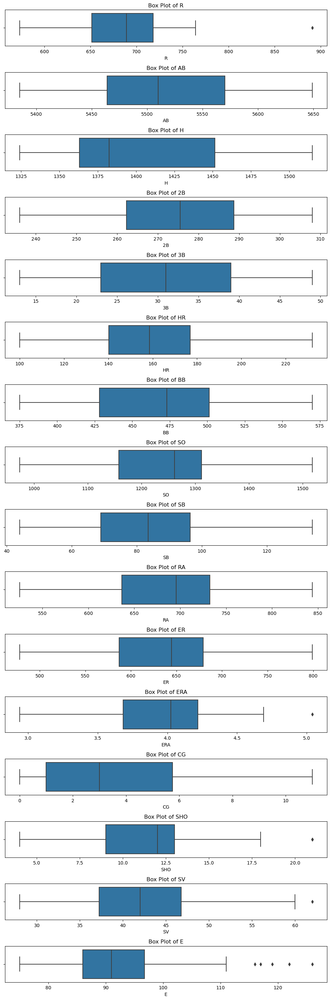

In [39]:
plt.figure(figsize=(10,30))

for i, column in enumerate(columns):
    plt.subplot(len(columns), 1, i + 1)
    sns.boxplot(x=df[column])
    plt.title(f'Box Plot of {column}')
    plt.xlabel(column)

plt.tight_layout()
plt.show()

>The variables with outliers are R (Runs), ERA (Earned Run Average), SHO (Shutouts), SV (Saves), and E (Errors), showing a few extreme values above the normal range.

# Remove Outliers using 'IQR'

In [40]:
 #Columns with outliers
outlier_columns = ['R', 'ERA', 'SHO', 'SV', 'E']

for col in outlier_columns:
    # Calculate Q1 (25th percentile) and Q3 (75th percentile)
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    
    # Calculate IQR
    IQR = Q3 - Q1
    
    # Calculate outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Identify outliers
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    
    print(f'{col} - IQR: {IQR}, Lower Bound: {lower_bound}, Upper Bound: {upper_bound}')
    print(f'Outliers in {col}:\n{outliers[col]}')

R - IQR: 67.0, Lower Bound: 550.75, Upper Bound: 818.75
Outliers in R:
5    891
Name: R, dtype: int64
ERA - IQR: 0.5375000000000005, Lower Bound: 2.8762499999999993, Upper Bound: 5.026250000000001
Outliers in ERA:
29    5.04
Name: ERA, dtype: float64
SHO - IQR: 4.0, Lower Bound: 3.0, Upper Bound: 19.0
Outliers in SHO:
17    21
25    21
Name: SHO, dtype: int64
SV - IQR: 9.5, Lower Bound: 23.0, Upper Bound: 61.0
Outliers in SV:
15    62
Name: SV, dtype: int64
E - IQR: 10.75, Lower Bound: 69.875, Upper Bound: 112.875
Outliers in E:
10    119
14    126
16    122
18    116
24    117
Name: E, dtype: int64


In [41]:
# Print cleaned DataFrame
print(f'Cleaned DataFrame:\n{df}')

Cleaned DataFrame:
      W    R    AB     H   2B  3B   HR   BB    SO   SB   RA   ER   ERA  CG  \
0    95  724  5575  1497  300  42  139  383   973  104  641  601  3.73   2   
1    83  696  5467  1349  277  44  156  439  1264   70  700  653  4.07   2   
2    81  669  5439  1395  303  29  141  533  1157   86  640  584  3.67  11   
3    76  622  5533  1381  260  27  136  404  1231   68  701  643  3.98   7   
4    74  689  5605  1515  289  49  151  455  1259   83  803  746  4.64   7   
5    93  891  5509  1480  308  17  232  570  1151   88  670  609  3.80   7   
6    87  764  5567  1397  272  19  212  554  1227   63  698  652  4.03   3   
7    81  713  5485  1370  246  20  217  418  1331   44  693  646  4.05   0   
8    80  644  5485  1383  278  32  167  436  1310   87  642  604  3.74   1   
9    78  748  5640  1495  294  33  161  478  1148   71  753  694  4.31   3   
10   88  751  5511  1419  279  32  172  503  1233  101  733  680  4.24   5   
11   86  729  5459  1363  278  26  230  486  

# Check Skewness

In [42]:
df.skew()

W      0.047089
R      1.200786
AB     0.183437
H      0.670254
2B    -0.230650
3B     0.129502
HR     0.516441
BB     0.158498
SO    -0.156065
SB     0.479893
RA     0.045734
ER     0.058710
ERA    0.053331
CG     0.736845
SHO    0.565790
SV     0.657524
E      0.890132
dtype: float64

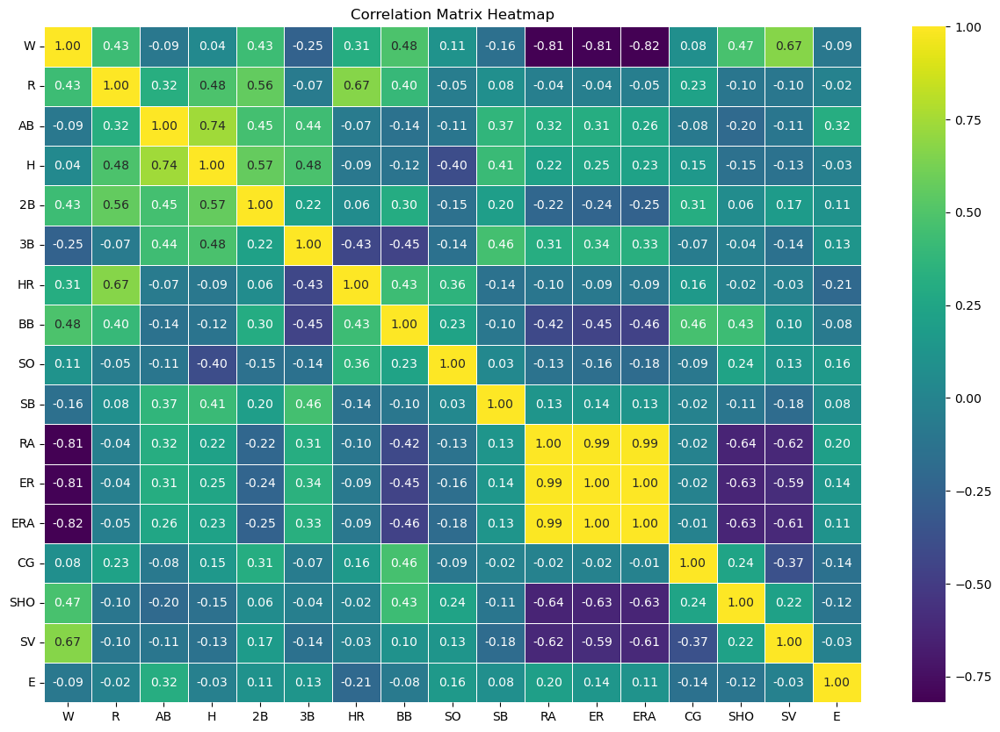

In [43]:
# Calculate the correlation matrix
correlation_matrix = df.corr()

# Create a heatmap
plt.figure(figsize=(15, 10))  
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt='.2f', linewidths=0.5)
plt.yticks(rotation = 0)

# Display it
plt.title('Correlation Matrix Heatmap')
plt.show()

observation:

  1.  W (Wins) has a strong negative correlation with RA (Runs Allowed) (-0.81), ER (Earned Runs) (-0.81), and ERA (Earned Run Average) (-0.82). This suggests that as runs allowed, earned runs, and ERA decrease, the number of wins increases.

  2.  R (Runs) shows a positive correlation with H (Hits) (0.48), BB (Walks) (0.67), and HR (Home Runs) (0.31), indicating that these factors contribute to scoring more runs.

  3.  H (Hits) and AB (At Bats) have a strong correlation (0.74), meaning more at-bats typically lead to more hits.

  4.  ERA (Earned Run Average) is highly positively correlated with RA (Runs Allowed) (0.99) and ER (Earned Runs) (0.99). These are strongly related metrics regarding pitching performance.

  5.  SO (Strikeouts) and BB (Walks) show a weak correlation (-0.16), meaning strikeouts and walks are not strongly related.

  6.  SV (Saves) has a moderate positive correlation with W (Wins) (0.67) and SHO (Shutouts) (0.43), meaning more saves often lead to more wins and shutouts.

# Multicollinearity Identification

In [44]:
#function to find multicollinearity

def find_multicollinearity(data):
   
    data_with_const = sma.add_constant(data)
    vif_data = pd.DataFrame()
    vif_data["Feature"] = data_with_const.columns
    vif_data["VIF"] = [variance_inflation_factor(data_with_const.values, i) for i in range(data_with_const.shape[1])]
    vif_data = vif_data[vif_data["Feature"] != "const"]
    
    return vif_data

In [45]:
vif_result = find_multicollinearity(df)
print(vif_result)

   Feature          VIF
1        W    19.891017
2        R    23.249385
3       AB    13.665681
4        H    10.070734
5       2B     4.883096
6       3B     3.304753
7       HR    10.967594
8       BB     4.269219
9       SO     2.661169
10      SB     2.123260
11      RA   197.480090
12      ER  1706.597165
13     ERA  1317.056521
14      CG     4.117687
15     SHO     3.883391
16      SV    10.957250
17       E     2.199067


> Based on the VIF values we got, several features have high multicollinearity. 

> Features like ER, ERA, and RA have extremely high VIF values, indicating severe multicollinearity.

In [46]:
# Drop 'ER' and 'RA' as they have very high VIFs
df = df.drop(columns=['ER', 'RA'])

# Recalculation of VIF
vif_result = find_multicollinearity(df)
print(vif_result)


   Feature        VIF
1        W  17.899829
2        R  21.867119
3       AB   4.412891
4        H   9.050526
5       2B   4.484172
6       3B   3.143113
7       HR   9.075099
8       BB   3.711412
9       SO   2.223568
10      SB   1.835898
11     ERA   9.534415
12      CG   3.730130
13     SHO   3.377586
14      SV   7.775123
15       E   2.044907


> Since ERA (Earned Run Average) is often directly correlated with ER (Earned Run) and RA (Run Average), it makes sense to keep only one of these features.

In [47]:
df.shape

(30, 15)

In [48]:
df.corr()

,W,R,AB,H,2B,3B,HR,BB,SO,SB,ERA,CG,SHO,SV,E
W,1.000000,0.430751,-0.087947,0.037612,0.427797,-0.251118,0.307407,0.484342,0.111850,-0.157234,-0.819600,0.080533,0.471805,0.666530,-0.089485
R,0.430751,1.000000,0.319464,0.482856,0.560084,-0.070072,0.671283,0.402452,-0.054726,0.081367,-0.049281,0.232042,-0.103274,-0.096380,-0.023262
AB,-0.087947,0.319464,1.000000,0.739122,0.453370,0.435422,-0.066983,-0.136414,-0.106022,0.372618,0.255551,-0.080876,-0.197321,-0.106367,0.316743
H,0.037612,0.482856,0.739122,1.000000,0.566847,0.478694,-0.090855,-0.118281,-0.398830,0.413444,0.231172,0.147955,-0.145559,-0.130371,-0.033173
2B,0.427797,0.560084,0.453370,0.566847,1.000000,0.220490,0.056292,0.302700,-0.150752,0.195027,-0.254854,0.306675,0.057998,0.171576,0.105754
3B,-0.251118,-0.070072,0.435422,0.478694,0.220490,1.000000,-0.430915,-0.454949,-0.141196,0.457437,0.330951,-0.065898,-0.041396,-0.142370,0.126678
HR,0.307407,0.671283,-0.066983,-0.090855,0.056292,-0.430915,1.000000,0.425691,0.359923,-0.136567,-0.090917,0.156502,-0.019119,-0.028540,-0.207597
BB,0.484342,0.402452,-0.136414,-0.118281,0.302700,-0.454949,0.425691,1.000000,0.233652,-0.098347,-0.459832,0.462478,0.426004,0.099445,-0.075685
SO,0.111850,-0.054726,-0.106022,-0.398830,-0.150752,-0.141196,0.359923,0.233652,1.000000,0.030968,-0.180368,-0.093418,0.237721,0.126297,0.155133
SB,-0.157234,0.081367,0.372618,0.413444,0.195027,0.457437,-0.136567,-0.098347,0.030968,1.000000,0.126063,-0.020783,-0.106563,-0.183418,0.079149


In [49]:
df.corr().W.sort_values()

ERA   -0.819600
3B    -0.251118
SB    -0.157234
E     -0.089485
AB    -0.087947
H      0.037612
CG     0.080533
SO     0.111850
HR     0.307407
2B     0.427797
R      0.430751
SHO    0.471805
BB     0.484342
SV     0.666530
W      1.000000
Name: W, dtype: float64

# Seperate features  and target  variable

In [50]:
X = df.drop('W', axis=1)  
Y = df['W'] 

In [51]:
# Split the data into training and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# shapes of the resulting datasets
print(f"Training features shape: {X_train.shape}")
print(f"Test features shape: {X_test.shape}")
print(f"Training target shape: {Y_train.shape}")
print(f"Test target shape: {Y_test.shape}")

Training features shape: (24, 14)
Test features shape: (6, 14)
Training target shape: (24,)
Test target shape: (6,)


# Initialization and Model Training

In [52]:
# Initialize and train the Linear Regression model
lr = LinearRegression()
lr.fit(X_train, Y_train)
pred_lr = lr.predict(X_test)

# Evaluate the model
print("Linear Regression:")
print("R^2 score:", r2_score(Y_test, pred_lr))
print("Mean Absolute Error:", mean_absolute_error(Y_test, pred_lr))
print("Mean Squared Error:", mean_squared_error(Y_test, pred_lr))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, pred_lr)))
print("\n")

Linear Regression:
R^2 score: 0.7722057272747227
Mean Absolute Error: 3.9458654664880464
Mean Squared Error: 29.97392971943441
Root Mean Squared Error: 5.474845177667986




In [53]:
# Initialize and train the Random Forest model
rf = RandomForestRegressor()
rf.fit(X_train, Y_train)
pred_rf = rf.predict(X_test)

# Evaluate the model
print("Random Forest Regressor:")
print("R^2 score:", r2_score(Y_test, pred_rf))
print("Mean Absolute Error:", mean_absolute_error(Y_test, pred_rf))
print("Mean Squared Error:", mean_squared_error(Y_test, pred_rf))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, pred_rf)))
print("\n")

Random Forest Regressor:
R^2 score: 0.5054283723875872
Mean Absolute Error: 6.598333333333334
Mean Squared Error: 65.07738333333332
Root Mean Squared Error: 8.06705543140329




In [54]:
# Initialize and train the Decision Tree model
dt = DecisionTreeRegressor()
dt.fit(X_train, Y_train)
pred_dt = dt.predict(X_test)

# Evaluate the model
print("Decision Tree Regressor:")
print("R^2 score:", r2_score(Y_test, pred_dt))
print("Mean Absolute Error:", mean_absolute_error(Y_test, pred_dt))
print("Mean Squared Error:", mean_squared_error(Y_test, pred_dt))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, pred_dt)))
print("\n")

Decision Tree Regressor:
R^2 score: 0.061431285623812504
Mean Absolute Error: 9.833333333333334
Mean Squared Error: 123.5
Root Mean Squared Error: 11.113055385446435




In [55]:
# Initialize and train the Gradient Boosting Regressor model
gbr = GradientBoostingRegressor()
gbr.fit(X_train, Y_train)
pred_gbr = gbr.predict(X_test)

# Evaluate the model
print("Gradient Boosting Regressor:")
print("R^2 score:", r2_score(Y_test, pred_gbr))
print("Mean Absolute Error:", mean_absolute_error(Y_test, pred_gbr))
print("Mean Squared Error:", mean_squared_error(Y_test, pred_gbr))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, pred_gbr)))

Gradient Boosting Regressor:
R^2 score: 0.4905684892734956
Mean Absolute Error: 7.323139547726107
Mean Squared Error: 67.0326962864292
Root Mean Squared Error: 8.187349771838822


In [56]:
# Initialize and train the Lasso model
lasso = Lasso(alpha=0.1)  # You can adjust the alpha value for regularization
lasso.fit(X_train, Y_train)
pred_lasso = lasso.predict(X_test)

# Evaluate the model
print("Lasso Regression:")
print("R^2 score:", r2_score(Y_test, pred_lasso))
print("Mean Absolute Error:", mean_absolute_error(Y_test, pred_lasso))
print("Mean Squared Error:", mean_squared_error(Y_test, pred_lasso))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, pred_lasso)))

Lasso Regression:
R^2 score: 0.7365228333103344
Mean Absolute Error: 4.226243778933745
Mean Squared Error: 34.66920385024851
Root Mean Squared Error: 5.888056033212363


# checking overfitting

continuing with the best among above model

In [57]:
# Initialize and train the Linear Regression model
lr = LinearRegression()
lr.fit(X_train, Y_train)

# Predict on training data
train_pred_lr = lr.predict(X_train)

# Predict on test data
test_pred_lr = lr.predict(X_test)

# Evaluate training metrics
print("Training Metrics for Linear Regression:")
print("R^2 score:", r2_score(Y_train, train_pred_lr))
print("Mean Absolute Error:", mean_absolute_error(Y_train, train_pred_lr))
print("Mean Squared Error:", mean_squared_error(Y_train, train_pred_lr))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_train, train_pred_lr)))

# Evaluate test metrics
print("\nTest Metrics for Linear Regression:")
print("R^2 score:", r2_score(Y_test, test_pred_lr))
print("Mean Absolute Error:", mean_absolute_error(Y_test, test_pred_lr))
print("Mean Squared Error:", mean_squared_error(Y_test, test_pred_lr))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, test_pred_lr)))


Training Metrics for Linear Regression:
R^2 score: 0.9671013315362035
Mean Absolute Error: 1.4129496321400128
Mean Squared Error: 3.195740100497119
Root Mean Squared Error: 1.7876633073644261

Test Metrics for Linear Regression:
R^2 score: 0.7722057272747227
Mean Absolute Error: 3.9458654664880464
Mean Squared Error: 29.97392971943441
Root Mean Squared Error: 5.474845177667986


In [58]:
# Initialize and train the Lasso model
lasso = Lasso(alpha=0.1)
lasso.fit(X_train, Y_train)

# Predict on training data
train_pred_lasso = lasso.predict(X_train)

# Predict on test data
test_pred_lasso = lasso.predict(X_test)

# Evaluate training metrics
print("Training Metrics for Lasso Regression:")
print("R^2 score:", r2_score(Y_train, train_pred_lasso))
print("Mean Absolute Error:", mean_absolute_error(Y_train, train_pred_lasso))
print("Mean Squared Error:", mean_squared_error(Y_train, train_pred_lasso))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_train, train_pred_lasso)))

# Evaluate test metrics
print("\nTest Metrics for Lasso Regression:")
print("R^2 score:", r2_score(Y_test, test_pred_lasso))
print("Mean Absolute Error:", mean_absolute_error(Y_test, test_pred_lasso))
print("Mean Squared Error:", mean_squared_error(Y_test, test_pred_lasso))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, test_pred_lasso)))


Training Metrics for Lasso Regression:
R^2 score: 0.9636528378264217
Mean Absolute Error: 1.4842169726610974
Mean Squared Error: 3.530722947805637
Root Mean Squared Error: 1.8790218061016846

Test Metrics for Lasso Regression:
R^2 score: 0.7365228333103344
Mean Absolute Error: 4.226243778933745
Mean Squared Error: 34.66920385024851
Root Mean Squared Error: 5.888056033212363


# hyperparameter tunning and cross validation

In [59]:
# Define the parameter grid
param_grid = {'alpha': [0.01, 0.1, 1, 10, 100]}


ridge = Ridge()
grid_search_ridge = GridSearchCV(estimator=ridge, param_grid=param_grid, scoring='r2', cv=5)
grid_search_ridge.fit(X_train, Y_train)

# Best parameters and score
print("Best Parameters for Ridge Regression:", grid_search_ridge.best_params_)
print("Best Cross-Validation Score for Ridge Regression:", grid_search_ridge.best_score_)

# Train and evaluate the best Ridge model
best_ridge = grid_search_ridge.best_estimator_
train_pred_ridge = best_ridge.predict(X_train)
test_pred_ridge = best_ridge.predict(X_test)

print("\nTraining Metrics for Best Ridge Regression:")
print("R^2 score:", r2_score(Y_train, train_pred_ridge))
print("Mean Absolute Error:", mean_absolute_error(Y_train, train_pred_ridge))
print("Mean Squared Error:", mean_squared_error(Y_train, train_pred_ridge))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_train, train_pred_ridge)))

print("\nTest Metrics for Best Ridge Regression:")
print("R^2 score:", r2_score(Y_test, test_pred_ridge))
print("Mean Absolute Error:", mean_absolute_error(Y_test, test_pred_ridge))
print("Mean Squared Error:", mean_squared_error(Y_test, test_pred_ridge))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, test_pred_ridge)))


NameError: name 'Ridge' is not defined

In [60]:
# Define the parameter grid
param_grid = {'alpha': [0.01, 0.1, 1, 10]}


lasso = Lasso()
grid_search_lasso = GridSearchCV(estimator=lasso, param_grid=param_grid, scoring='r2', cv=5)
grid_search_lasso.fit(X_train, Y_train)

# Best parameters and score
print("Best Parameters for Lasso Regression:", grid_search_lasso.best_params_)
print("Best Cross-Validation Score for Lasso Regression:", grid_search_lasso.best_score_)

# Train and evaluate the best Lasso model
best_lasso = grid_search_lasso.best_estimator_
train_pred_lasso = best_lasso.predict(X_train)
test_pred_lasso = best_lasso.predict(X_test)

print("\nTraining Metrics for Best Lasso Regression:")
print("R^2 score:", r2_score(Y_train, train_pred_lasso))
print("Mean Absolute Error:", mean_absolute_error(Y_train, train_pred_lasso))
print("Mean Squared Error:", mean_squared_error(Y_train, train_pred_lasso))
print("Root Mean Squared Error:", np.sqrt(mean_squared_error(Y_test, test_pred_lasso)))


Best Parameters for Lasso Regression: {'alpha': 1}
Best Cross-Validation Score for Lasso Regression: 0.40796034876940385

Training Metrics for Best Lasso Regression:
R^2 score: 0.9364428029610515
Mean Absolute Error: 1.8830862386847513
Mean Squared Error: 6.173875501255637
Root Mean Squared Error: 7.590050232193753


Hence we found lasso is overall best amongst all,hence we proceed it with furthur.

# Re-train of the model

In [61]:
# Initialize the final Lasso Regression model with the best parameters
final_lasso = Lasso(alpha=1)

# Train the model on the full dataset
final_lasso.fit(X, Y)


Lasso(alpha=1)

# save the model

In [62]:
import joblib

# Save the trained model
joblib.dump(final_lasso, 'final_lasso_model.pkl')

['final_lasso_model.pkl']

# ==========xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx===========

# Avocado Project

In [80]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from scipy.stats import zscore
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.svm import SVR
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import joblib

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/dsrscientist/Data-Science-ML-Capstone-Projects/master/avocado.csv ')
df

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0.0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015.0,Albany
1,1.0,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015.0,Albany
2,2.0,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015.0,Albany
3,3.0,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015.0,Albany
4,4.0,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015.0,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16463,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The dataset is loaded successfully with 16,468 rows and 14 columns, and it contains both numerical and categorical features.

In [3]:
df.head()

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0.0,27-12-2015,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015.0,Albany
1,1.0,20-12-2015,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015.0,Albany
2,2.0,13-12-2015,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015.0,Albany
3,3.0,06-12-2015,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015.0,Albany
4,4.0,29-11-2015,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015.0,Albany


In [4]:
df.tail()

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
16463,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


we can see a lot of missing data.

# Exploratory Data Analysis(EDA)

In [5]:
df.shape

(16468, 14)

The dataset has 16,468 rows and 14 columns, indicating a reasonably large dataset.

In [6]:
df.columns

Index(['Unnamed: 0', 'Date', 'AveragePrice', 'Total Volume', '4046', '4225',
       '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags', 'type',
       'year', 'region'],
      dtype='object')

In [7]:
df.dtypes

Unnamed: 0      float64
Date             object
AveragePrice    float64
Total Volume    float64
4046            float64
4225            float64
4770            float64
Total Bags      float64
Small Bags      float64
Large Bags      float64
XLarge Bags     float64
type             object
year            float64
region           object
dtype: object

 The dataset contains a mix of float (for numerical data) and object (for dates and categorical data).

In [8]:
#checking the null values
df.isnull().sum()

Unnamed: 0      14951
Date            14951
AveragePrice    14951
Total Volume    14951
4046            14951
4225            14951
4770            14951
Total Bags      14951
Small Bags      14951
Large Bags      14951
XLarge Bags     14951
type            14951
year            14951
region          14951
dtype: int64

A large number of null values are present in almost all columns, indicating potential issues in data completeness.

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16468 entries, 0 to 16467
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Unnamed: 0    1517 non-null   float64
 1   Date          1517 non-null   object 
 2   AveragePrice  1517 non-null   float64
 3   Total Volume  1517 non-null   float64
 4   4046          1517 non-null   float64
 5   4225          1517 non-null   float64
 6   4770          1517 non-null   float64
 7   Total Bags    1517 non-null   float64
 8   Small Bags    1517 non-null   float64
 9   Large Bags    1517 non-null   float64
 10  XLarge Bags   1517 non-null   float64
 11  type          1517 non-null   object 
 12  year          1517 non-null   float64
 13  region        1517 non-null   object 
dtypes: float64(11), object(3)
memory usage: 1.8+ MB


Out of 16,468 rows, only 1,517 rows have non-null values across all columns, confirming a significant amount of missing data that will need to be addressed.

<Axes: >

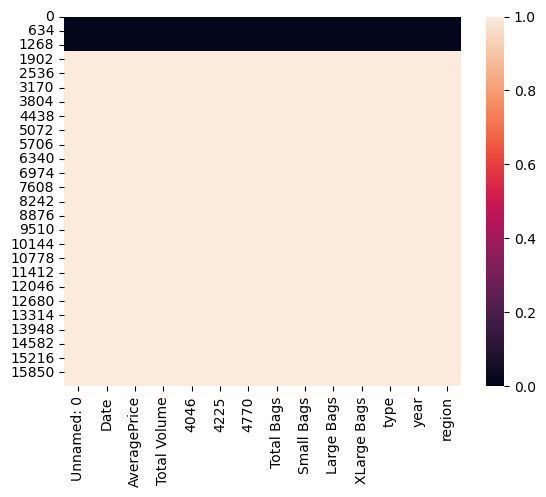

In [10]:
#lets visualise above data using heatmap
sns.heatmap(df.isnull())

# Desceiption

In [11]:
df.describe()

,Unnamed: 0,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,year
count,1517.000000,1517.000000,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1.517000e+03,1517.000000,1517.000000
mean,26.995386,1.074990,1.601879e+06,6.464387e+05,6.114375e+05,5.040550e+04,2.935974e+05,2.487736e+05,4.264205e+04,2181.771074,2015.162821
std,14.848287,0.188891,4.433143e+06,1.947614e+06,1.672906e+06,1.377812e+05,7.579765e+05,6.474765e+05,1.182157e+05,7455.712144,0.369324
min,0.000000,0.490000,3.875074e+04,4.677200e+02,1.783770e+03,0.000000e+00,3.311770e+03,3.311770e+03,0.000000e+00,0.000000,2015.000000
25%,14.000000,0.980000,1.474700e+05,2.040034e+04,4.147606e+04,9.112500e+02,3.620689e+04,2.972722e+04,5.407400e+02,0.000000,2015.000000
50%,29.000000,1.080000,4.027919e+05,8.175117e+04,1.186649e+05,7.688170e+03,7.397906e+04,6.237569e+04,5.044350e+03,0.000000,2015.000000
75%,39.000000,1.190000,9.819751e+05,3.775785e+05,4.851503e+05,2.916730e+04,1.576097e+05,1.461994e+05,2.926767e+04,401.480000,2015.000000
max,51.000000,1.680000,4.465546e+07,1.893304e+07,1.895648e+07,1.381516e+06,6.736304e+06,5.893642e+06,1.121076e+06,108072.790000,2016.000000


# Handling Missing Values

In [12]:
print("Shape before dropping NaNs:", df.shape)
df.dropna(inplace=True)
print("Shape after dropping NaNs:", df.shape)


Shape before dropping NaNs: (16468, 14)
Shape after dropping NaNs: (1517, 14)


 This step removes rows with missing values, leaving 1517 complete rows for further analysis.

# Drop unnecessary column

In [13]:
# Remove the unnecessary column
df.drop("Unnamed: 0", axis=1, inplace=True)
print("Shape after dropping 'Unnamed: 0':", df.shape)

Shape after dropping 'Unnamed: 0': (1517, 13)


# lets check it

In [14]:
print("NaN Values per Column:")
print(df.isnull().sum())

NaN Values per Column:
Date            0
AveragePrice    0
Total Volume    0
4046            0
4225            0
4770            0
Total Bags      0
Small Bags      0
Large Bags      0
XLarge Bags     0
type            0
year            0
region          0
dtype: int64


<Axes: >

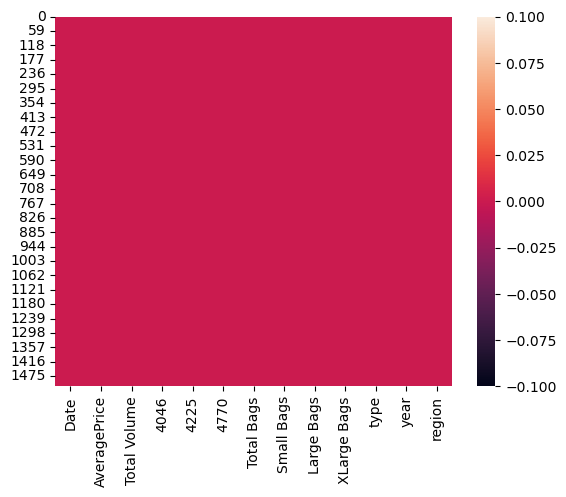

In [15]:
# visualize the null values in heatmap
sns.heatmap(df.isnull())

# checking uniqueness

In [16]:
df['AveragePrice'].unique()

array([1.33, 1.35, 0.93, 1.08, 1.28, 1.26, 0.99, 0.98, 1.02, 1.07, 1.12,
       1.31, 1.11, 1.34, 1.45, 1.05, 1.37, 1.27, 1.32, 1.23, 1.19, 1.43,
       1.2 , 1.22, 1.13, 1.16, 1.06, 1.17, 1.24, 0.96, 1.  , 1.09, 0.95,
       0.97, 1.15, 1.01, 1.14, 1.1 , 1.04, 1.18, 1.29, 1.25, 1.03, 1.39,
       1.4 , 1.36, 1.3 , 0.88, 1.21, 0.9 , 0.94, 0.75, 0.77, 0.81, 0.8 ,
       0.72, 0.79, 0.67, 0.82, 0.68, 0.76, 0.91, 1.38, 0.92, 0.78, 0.74,
       0.62, 0.83, 0.87, 0.73, 0.7 , 0.89, 0.85, 1.44, 1.42, 1.41, 0.49,
       0.53, 0.66, 0.56, 0.6 , 0.71, 0.65, 0.58, 0.54, 0.52, 0.51, 0.57,
       0.63, 0.64, 0.61, 0.84, 0.86, 0.69, 1.52, 1.53, 1.49, 1.48, 1.56,
       1.62, 1.63, 1.46, 1.51, 1.61, 1.47, 1.66, 1.57, 1.6 , 1.5 , 1.68,
       1.54, 1.64, 1.58])

In [17]:
df['region'].unique()

array(['Albany', 'Atlanta', 'BaltimoreWashington', 'Boise', 'Boston',
       'BuffaloRochester', 'California', 'Charlotte', 'Chicago',
       'Columbus', 'DallasFtWorth', 'Denver', 'Detroit', 'GrandRapids',
       'GreatLakes', 'HarrisburgScranton', 'HartfordSpringfield',
       'Houston', 'Indianapolis', 'Jacksonville', 'LasVegas',
       'LosAngeles', 'Louisville', 'MiamiFtLauderdale', 'Midsouth',
       'Nashville', 'NewYork', 'Northeast', 'NorthernNewEngland',
       'Orlando', 'Philadelphia', 'PhoenixTucson', 'Pittsburgh', 'Plains',
       'Portland', 'RaleighGreensboro', 'RichmondNorfolk', 'Roanoke',
       'SanDiego', 'SanFrancisco', 'Seattle', 'SouthCarolina',
       'SouthCentral', 'Southeast', 'Spokane', 'StLouis', 'Syracuse',
       'Tampa', 'TotalUS', 'West', 'WestTexNewMexico'], dtype=object)

In [18]:
# Lets change date column from object data type to datetime data type
df['Date'] = pd.to_datetime(df['Date'])

In [19]:
#Extract useful date features (like year, month, day)
df['year'] = df['Date'].dt.year
df['month'] = df['Date'].dt.month
df['day'] = df['Date'].dt.day

# drop  'Date' 
df.drop('Date', axis=1, inplace=True)


# seperating numerical and categorical column

In [20]:
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns

In [21]:
print(numerical_columns)

Index(['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags',
       'Small Bags', 'Large Bags', 'XLarge Bags'],
      dtype='object')


In [22]:
categorical_columns = df.select_dtypes(include=['object']).columns

In [23]:
print(categorical_columns)

Index(['type', 'region'], dtype='object')


# visualization

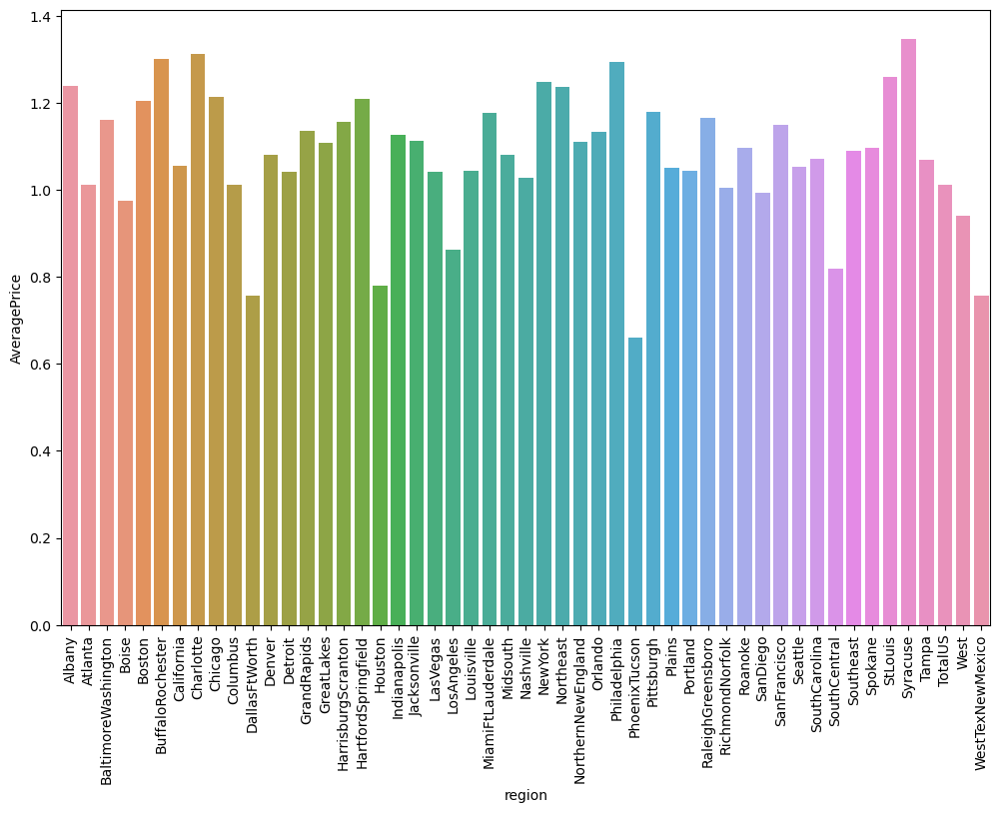

In [24]:
plt.figure(figsize=(12, 8))
sns.barplot(x='region', y='AveragePrice', data=df, ci=None)  # `ci=None` removes the error bars
plt.xticks(rotation=90)
plt.show()

[2015 2016]


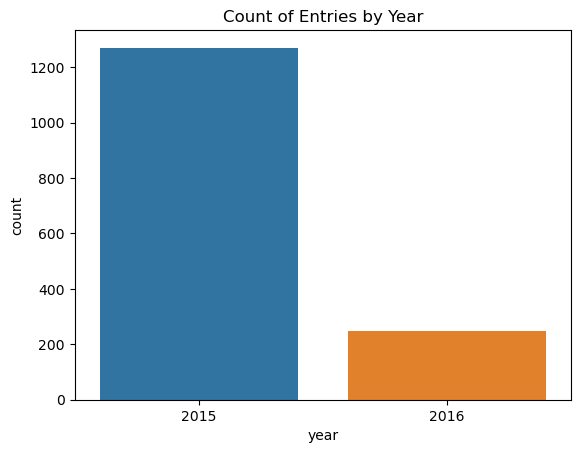

In [25]:
# Print unique values in the 'year' column
print(df['year'].unique())

# Plot 
sns.countplot(x='year', data=df)
plt.title('Count of Entries by Year')
plt.show()


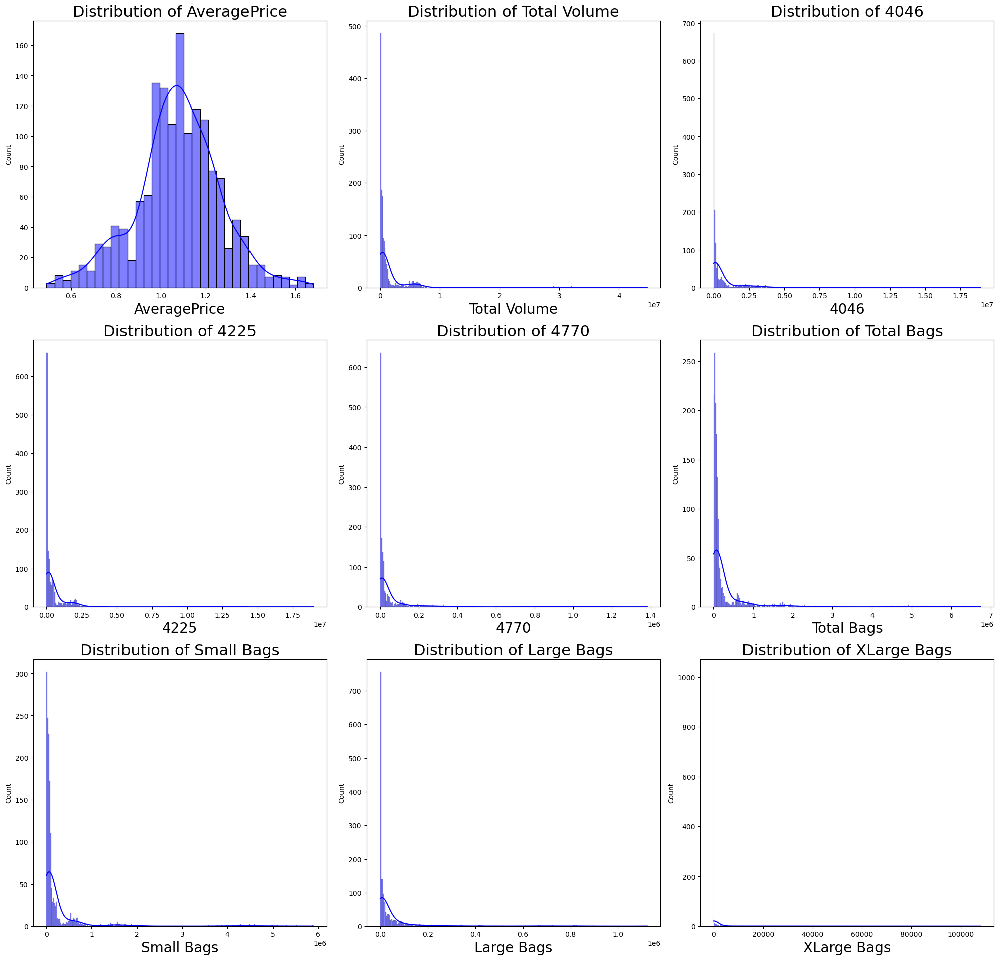

In [26]:
plt.figure(figsize=(20, 25), facecolor='white')

# Initialize plot number
plotnumber = 1

# Iterate over numerical columns and create subplots
for column in numerical_columns:
    if plotnumber <= 14:  
        ax = plt.subplot(4, 3, plotnumber)  
        sns.histplot(df[column], kde=True, color='b', ax=ax) 
        plt.xlabel(column, fontsize=20)
        plt.title(f'Distribution of {column}', fontsize=22) 
        plotnumber += 1

plt.tight_layout() 
plt.show()

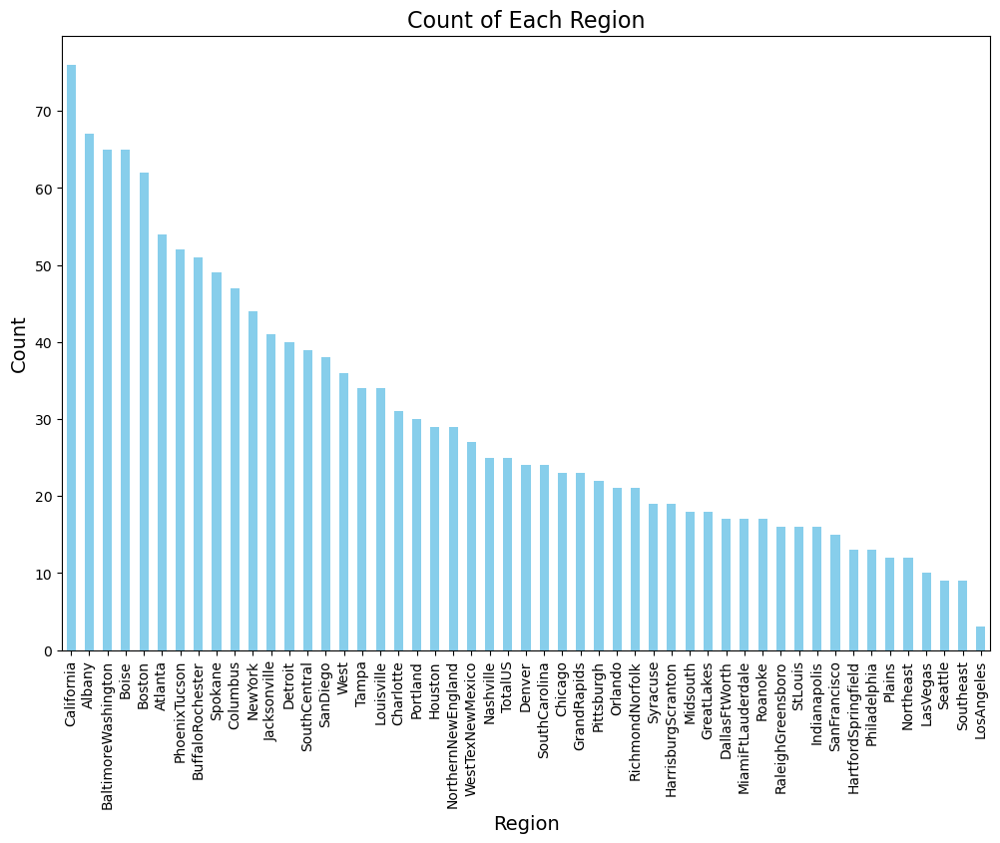

In [27]:
# Bar plot for 'region'
plt.figure(figsize=(12, 8))
df['region'].value_counts().plot(kind='bar', color='skyblue')
plt.xlabel('Region', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.title('Count of Each Region', fontsize=16)
plt.xticks(rotation=90)
plt.show()

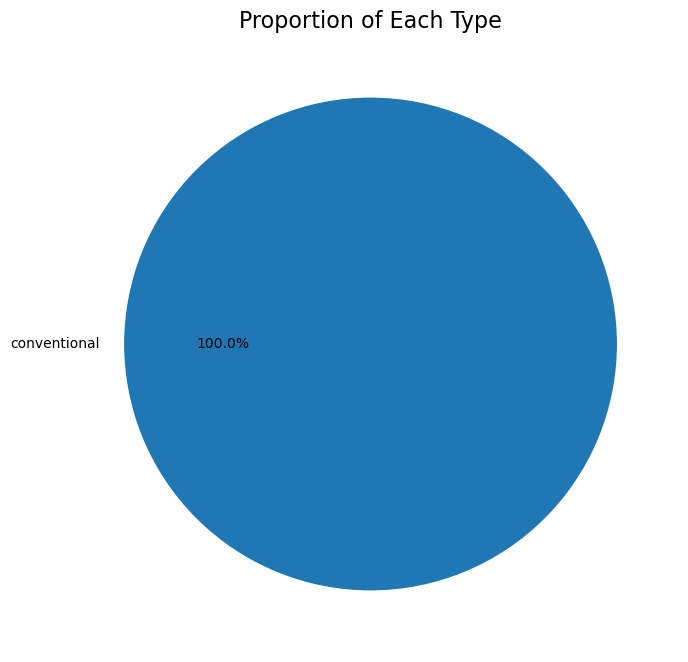

In [28]:
# Pie chart for 'type'
plt.figure(figsize=(8, 8))
df['type'].value_counts().plot(kind='pie', autopct='%1.1f%%')
plt.title('Proportion of Each Type', fontsize=16)
plt.ylabel('')
plt.show()

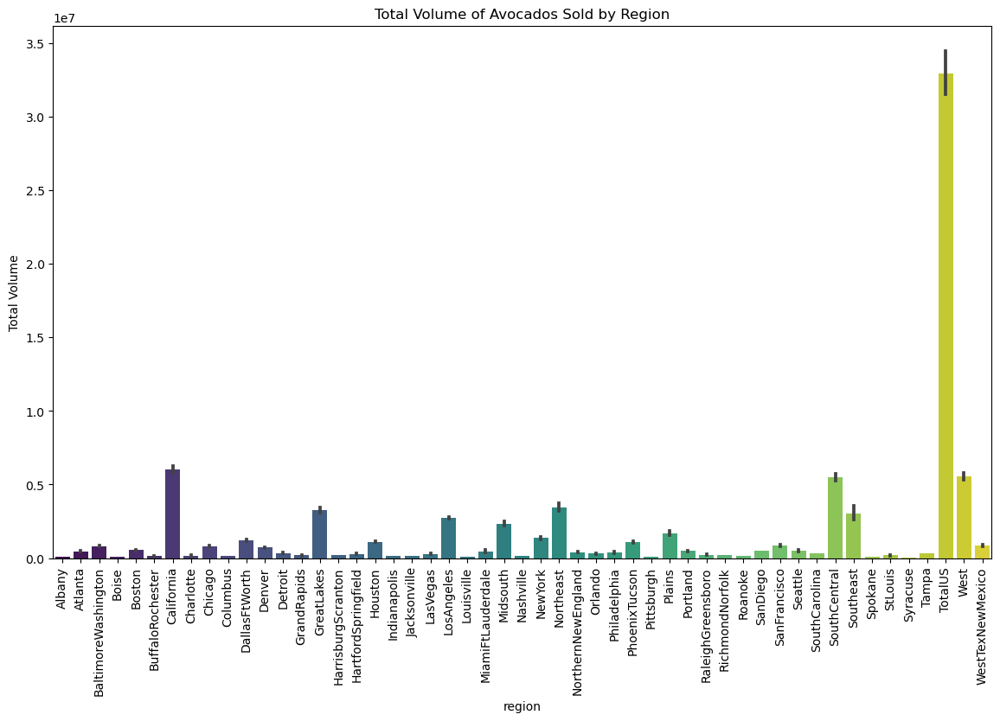

In [29]:
plt.figure(figsize=(14, 8))
sns.barplot(x='region', y='Total Volume', data=df, palette='viridis')
plt.xticks(rotation=90)
plt.title('Total Volume of Avocados Sold by Region')
plt.show()


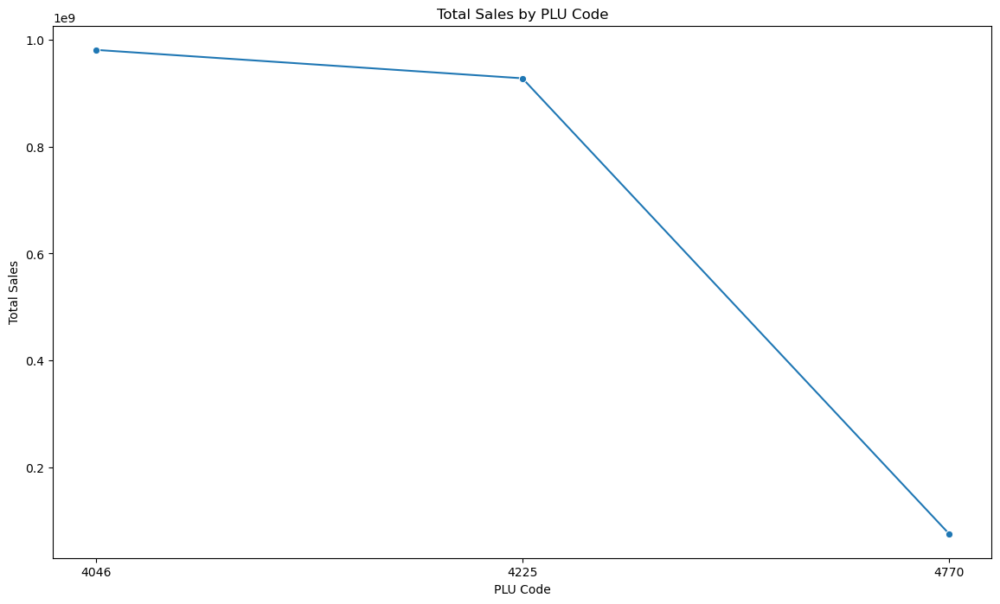

In [30]:
plt.figure(figsize=(14, 8))
sns.lineplot(data=df[['4046', '4225', '4770']].sum().reset_index(), x='index', y=0, marker='o', palette='tab10')
plt.xlabel('PLU Code')
plt.ylabel('Total Sales')
plt.title('Total Sales by PLU Code')
plt.show()


PLU 4046 and 4225 have similar high total sales, but there is a significant drop in sales for PLU 4770.

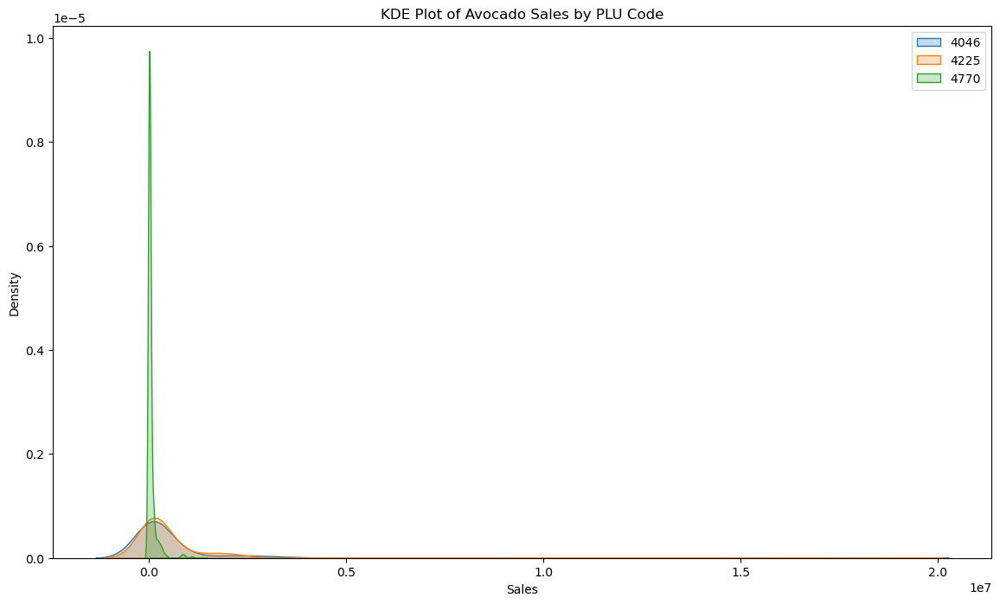

In [31]:
plt.figure(figsize=(14, 8))
sns.kdeplot(df['4046'], label='4046', fill=True)
sns.kdeplot(df['4225'], label='4225', fill=True)
sns.kdeplot(df['4770'], label='4770', fill=True)
plt.xlabel('Sales')
plt.title('KDE Plot of Avocado Sales by PLU Code')
plt.legend()
plt.show()


Most of the sales are concentrated around lower values (near zero), as shown by the sharp spike near the origin.
The three PLU codes have overlapping distributions, but PLU 4770 appears to have a particularly sharp peak near zero, suggesting that a significant portion of its sales volumes are relatively small.
The long tail stretching to the right indicates that there are a few very large sales values, but they are much less frequent.

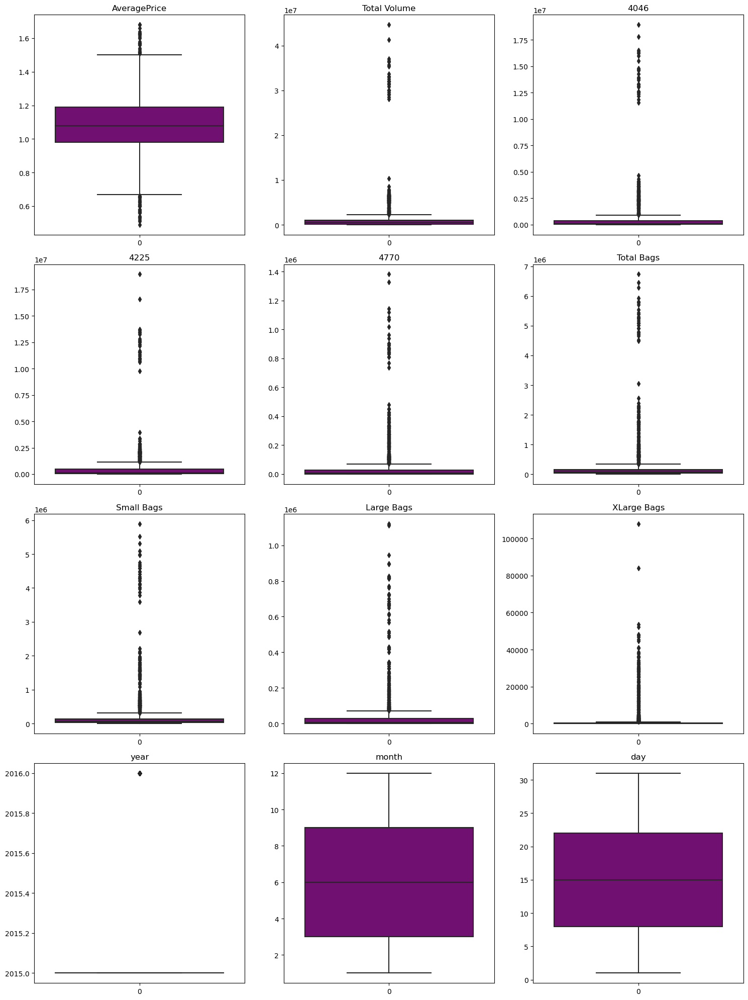

In [32]:
# Define numerical columns
numerical_col = ['AveragePrice', 'Total Volume', '4046', '4225', '4770', 
                 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags', 
                 'year', 'month', 'day']


fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15, 20))
axes = axes.ravel()

# Plot boxplots for each column
for i, col in enumerate(numerical_col):
    sns.boxplot(data=df[col], ax=axes[i],color="purple")
    axes[i].set_title(col)

plt.tight_layout()
plt.show()


# remove outliers

In [33]:
df.columns

Index(['AveragePrice', 'Total Volume', '4046', '4225', '4770', 'Total Bags',
       'Small Bags', 'Large Bags', 'XLarge Bags', 'type', 'year', 'region',
       'month', 'day'],
      dtype='object')

In [34]:
# containing outliers

c_out = df[['Total Volume', '4046', '4225', '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags']]

In [35]:
#Zscore method

z = np.abs(zscore(c_out))

z

,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags
0,0.346966,0.331490,0.333053,0.365608,0.375994,0.371055,0.360044,0.292727
1,0.349078,0.331676,0.338923,0.365534,0.374927,0.369812,0.360008,0.292727
2,0.334785,0.331614,0.300348,0.365010,0.376722,0.371922,0.359960,0.292727
3,0.343636,0.331441,0.322576,0.365431,0.379802,0.375576,0.359701,0.292727
4,0.349944,0.331539,0.339401,0.365408,0.379310,0.375098,0.359160,0.292727
...,...,...,...,...,...,...,...,...
1512,0.318397,0.302475,0.331910,0.238672,0.309055,0.308916,0.273213,0.260489
1513,0.321242,0.309770,0.334407,0.224966,0.303931,0.299831,0.288090,0.292727
1514,0.321203,0.308209,0.333987,0.244443,0.305099,0.301950,0.290953,0.182037
1515,0.318784,0.304230,0.333568,0.238936,0.303098,0.298364,0.290783,0.292727


In [36]:
# Create new DataFrame with z-scores < 3
new_df = df[(z < 3).all(axis=1)]

print(new_df)

      AveragePrice  Total Volume      4046       4225      4770  Total Bags  \
0             1.33      64236.62   1036.74   54454.85     48.16     8696.87   
1             1.35      54876.98    674.28   44638.81     58.33     9505.56   
2             0.93     118220.22    794.70  109149.67    130.50     8145.35   
3             1.08      78992.15   1132.00   71976.41     72.58     5811.16   
4             1.28      51039.60    941.48   43838.39     75.78     6183.95   
...            ...           ...       ...        ...       ...         ...   
1512          1.39     190846.01  57529.11   56366.66  17531.78    59418.46   
1513          1.51     178235.75  43325.87   52189.61  19419.57    63300.70   
1514          1.48     178410.82  46364.75   52893.38  16736.92    62415.77   
1515          1.47     189131.52  54110.79   53593.58  17495.42    63931.73   
1516          1.43     182978.30  43116.41   54193.42  16563.91    69104.56   

      Small Bags  Large Bags  XLarge Bags          

In [37]:
df.shape

(1517, 14)

In [38]:
new_df.shape

(1439, 14)

# Label encoding

In [39]:
# Columns with catagorical data

categorical_col = ["type","region"]

In [40]:
LE = LabelEncoder()

new_df[categorical_col] = new_df[categorical_col].apply(LE.fit_transform)

new_df[categorical_col]

,type,region
0,0,0
1,0,0
2,0,0
3,0,0
4,0,0
...,...,...
1512,0,7
1513,0,7
1514,0,7
1515,0,7


In [41]:
# Apply Yeo-Johnson transformation to remove skewness

# Features
skewed_features = ['Total Volume', '4046', '4225', '4770', 'Total Bags', 'Small Bags', 'Large Bags', 'XLarge Bags']

scaler = PowerTransformer(method='yeo-johnson') 
new_df[skewed_features] = scaler.fit_transform(new_df[skewed_features].values)


new_df[skewed_features].head()


,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags
0,-1.575637,-1.726894,-0.507407,-1.646112,-2.006891,-1.828607,-1.062018,-0.847616
1,-1.749321,-1.882097,-0.635006,-1.592418,-1.911468,-1.731194,-1.052225,-0.847616
2,-0.944056,-1.823261,-0.061583,-1.355067,-2.077780,-1.902891,-1.039728,-0.847616
3,-1.354354,-1.694712,-0.328443,-1.529851,-2.451033,-2.296623,-0.980749,-0.847616
4,-1.830807,-1.761997,-0.646625,-1.517336,-2.381298,-2.235583,-0.887969,-0.847616


In [42]:
new_df.skew()

AveragePrice   -0.164097
Total Volume    0.053958
4046           -0.026242
4225            0.000767
4770           -0.055180
Total Bags     -0.000622
Small Bags      0.013991
Large Bags     -0.118151
XLarge Bags     0.478894
type            0.000000
year            1.992181
region          0.265686
month           0.244263
day             0.028390
dtype: float64

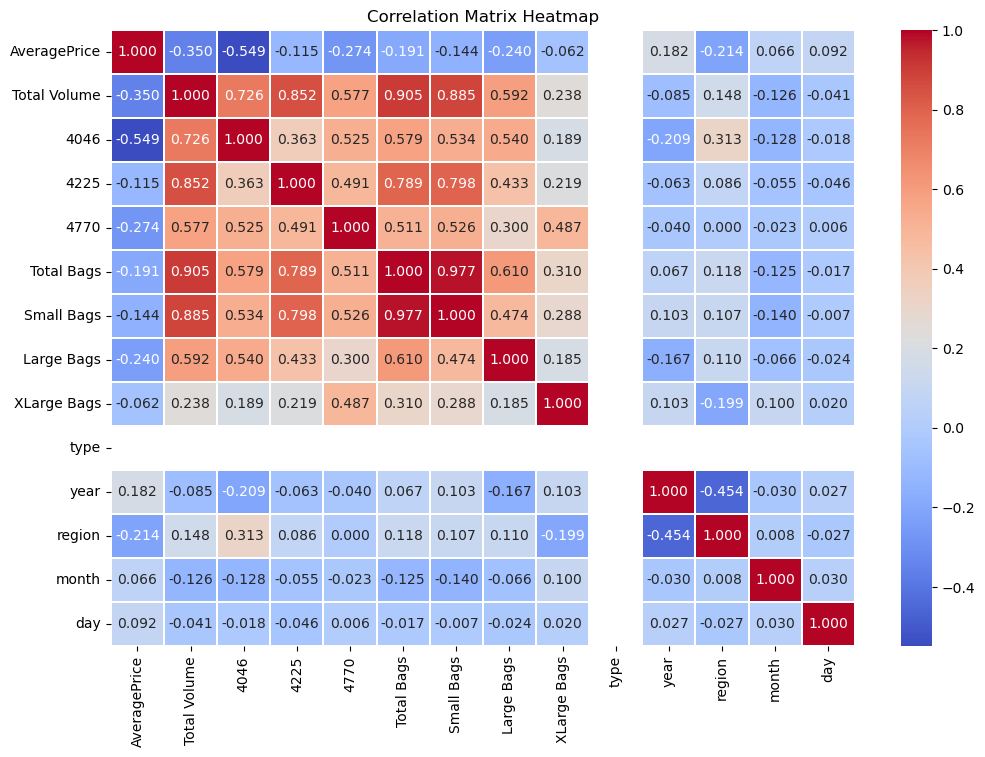

In [43]:
plt.figure(figsize=(12, 8))

# Plot the heatmap 
sns.heatmap(new_df.corr(), annot=True, linewidths=0.2, fmt='.3f', cmap='coolwarm')
plt.yticks(rotation=0)

plt.title('Correlation Matrix Heatmap')
plt.show()


# using VIF for multicollinearity

In [44]:
# Calculate the correlation matrix
corr = new_df.corr()

# Sort the correlation values for 'AveragePrice'
corr['AveragePrice'].sort_values(ascending=False)


AveragePrice    1.000000
year            0.182109
day             0.091843
month           0.066325
XLarge Bags    -0.061606
4225           -0.114572
Small Bags     -0.143875
Total Bags     -0.191489
region         -0.214139
Large Bags     -0.240406
4770           -0.273830
Total Volume   -0.349822
4046           -0.549127
type                 NaN
Name: AveragePrice, dtype: float64

# Visualization of corelation between label and features.

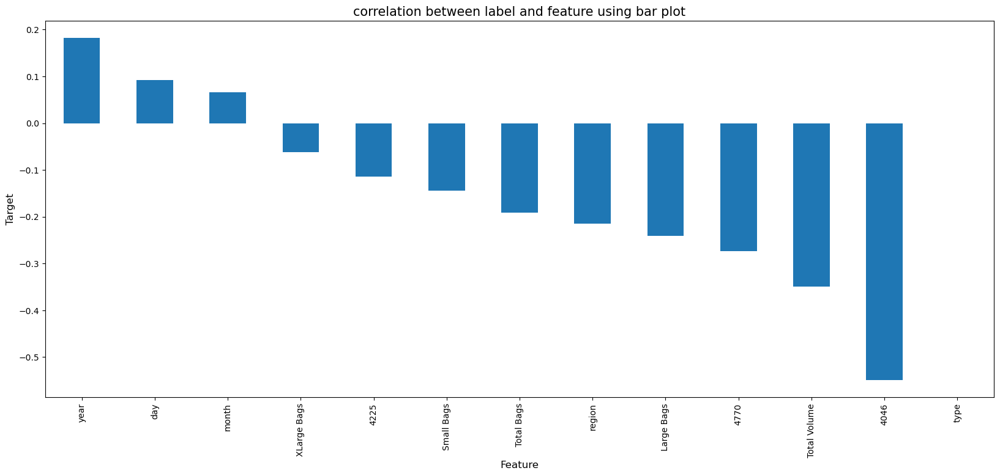

In [45]:
plt.figure(figsize = (20, 8))

new_df.corr()['AveragePrice'].sort_values(ascending=False).drop(['AveragePrice']).plot(kind = 'bar')

plt.xlabel('Feature',fontsize = 12)
plt.ylabel('Target',fontsize = 12)
plt.title('correlation between label and feature using bar plot', fontsize = 15)
plt.show()

# Regression Model

In [46]:
# seperate x & y labels

x = new_df.drop('AveragePrice', axis = 1)
y = new_df['AveragePrice']

In [47]:
x.shape

(1439, 13)

In [48]:
y.shape

(1439,)

In [49]:
x.head()

,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,month,day
0,-1.575637,-1.726894,-0.507407,-1.646112,-2.006891,-1.828607,-1.062018,-0.847616,0,2015,0,12,27
1,-1.749321,-1.882097,-0.635006,-1.592418,-1.911468,-1.731194,-1.052225,-0.847616,0,2015,0,12,20
2,-0.944056,-1.823261,-0.061583,-1.355067,-2.077780,-1.902891,-1.039728,-0.847616,0,2015,0,12,13
3,-1.354354,-1.694712,-0.328443,-1.529851,-2.451033,-2.296623,-0.980749,-0.847616,0,2015,0,12,6
4,-1.830807,-1.761997,-0.646625,-1.517336,-2.381298,-2.235583,-0.887969,-0.847616,0,2015,0,11,29


# Standarization

In [50]:
scaler = StandardScaler()

x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)
x

,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,month,day
0,-1.575637,-1.726894,-0.507407,-1.646112,-2.006891,-1.828607,-1.062018,-0.847616,0.0,-0.415667,-1.325366,1.736371,1.308936
1,-1.749321,-1.882097,-0.635006,-1.592418,-1.911468,-1.731194,-1.052225,-0.847616,0.0,-0.415667,-1.325366,1.736371,0.513706
2,-0.944056,-1.823261,-0.061583,-1.355067,-2.077780,-1.902891,-1.039728,-0.847616,0.0,-0.415667,-1.325366,1.736371,-0.281524
3,-1.354354,-1.694712,-0.328443,-1.529851,-2.451033,-2.296623,-0.980749,-0.847616,0.0,-0.415667,-1.325366,1.736371,-1.076754
4,-1.830807,-1.761997,-0.646625,-1.517336,-2.381298,-2.235583,-0.887969,-0.847616,0.0,-0.415667,-1.325366,1.440499,1.536145
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1434,-0.490996,-0.082356,-0.485263,0.531998,-0.132036,-0.123124,0.391176,1.171707,0.0,2.405771,-0.879922,1.144627,0.059289
1435,-0.553488,-0.210916,-0.534676,0.580732,-0.076543,-0.024129,0.314560,-0.847616,0.0,2.405771,-0.879922,1.144627,-0.735941
1436,-0.552585,-0.180364,-0.526079,0.510032,-0.088855,-0.046106,0.298274,1.358447,0.0,2.405771,-0.879922,1.144627,-1.531171
1437,-0.499205,-0.110303,-0.517639,0.531013,-0.067879,-0.009279,0.299258,-0.847616,0.0,2.405771,-0.879922,0.848755,1.081728


In [51]:
# Find Varience Inflation Factor (VIF) in each scaled column above.

vif = pd.DataFrame()
vif['VIF values'] = [variance_inflation_factor(x.values, i)
              for i in range(len(x.columns))]
vif['Features'] = x.columns

vif

,VIF values,Features
0,26.662242,Total Volume
1,6.491602,4046
2,8.683126,4225
3,2.174926,4770
4,65.985088,Total Bags
5,50.596218,Small Bags
6,3.673465,Large Bags
7,1.611033,XLarge Bags
8,NaN,type
9,1.574467,year


In [52]:
# Drop features with high VIF values
x.drop(['Total Volume', 'Total Bags', 'Small Bags'], axis=1, inplace=True)

# Check VIF values again
vif = pd.DataFrame()
vif['VIF values'] = [variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
vif['Features'] = x.columns

# Display updated VIF values
print(vif)

   VIF values     Features
0    2.082854         4046
1    1.513383         4225
2    2.070011         4770
3    1.620521   Large Bags
4    1.425044  XLarge Bags
5         NaN         type
6    1.290850         year
7    1.463652       region
8    1.046531        month
9    1.004865          day


# Finding best random state

In [53]:
max_acc = 0
best_random_state = 0

for i in range(1, 200):
    # Split 
    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    
    # Initialize and train the model
    model = KNeighborsRegressor()
    model.fit(X_train, y_train)
    
    predictions = model.predict(X_test)
    acc = r2_score(y_test, predictions)
    
    if acc > max_acc:
        max_acc = acc
        best_random_state = i

print(f'Maximum R² score is {max_acc:.4f} on random_state {best_random_state}')


Maximum R² score is 0.7679 on random_state 115


In [54]:
# Train & Test Split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = i)

# model training

In [55]:
#Linear regression
LR = LinearRegression()
LR.fit(x_train, y_train)

# prediction
predLR = LR.predict(x_test)
print('R2_score:', r2_score(y_test, predLR))
print('MAE:', metrics.mean_absolute_error(y_test, predLR))
print('MSE:', metrics.mean_squared_error(y_test, predLR))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predLR)))

# Checking Cross_Validation score for Linear Regression
print('Cross_Validaton_Score', cross_val_score(LR, x, y, cv = 5).mean())

R2_score: 0.3616443828663517
MAE: 0.12341730436295799
MSE: 0.024568699500472625
RMSE: 0.156744057305126
Cross_Validaton_Score -0.18298075705404493


In [56]:
#Kneighbour
# Checking R2 score for KNN Regressor
knn = KNN()

knn.fit(x_train, y_train)

# predict
predknn = knn.predict(x_test)

print('R2_Score:',r2_score(y_test, predknn))
print('MAE:',metrics.mean_absolute_error(y_test, predknn))
print('MSE:',metrics.mean_squared_error(y_test, predknn))
print('RMSE:',np.sqrt(metrics.mean_squared_error(y_test, predknn)))

# Checking Cross_Validaton score for KNN
print('Cross_Validaton_Score', cross_val_score(knn, x, y, cv = 5).mean())

R2_Score: 0.7176575876695515
MAE: 0.07956481481481481
MSE: 0.01086664814814815
RMSE: 0.10424321631716929
Cross_Validaton_Score -0.16874109014876498


In [57]:
#Randomforest
RFR = RandomForestRegressor()
RFR.fit(x_train, y_train)

# predict
pred_RFR = RFR.predict(x_test)
print('R2_Score:', r2_score(y_test, pred_RFR))

# Mean Absolute Error (MAE)
print('MAE:', metrics.mean_absolute_error(y_test, pred_RFR))

# Mean Squared Error (MSE)
print('MSE:', metrics.mean_squared_error(y_test, pred_RFR))

# Root Mean Squared Error (RMSE)
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, pred_RFR)))

# Checking Cross_Validation score for Random Forest Regression
print('Cross_Validaton_Score', cross_val_score(RFR, x, y, cv = 5).mean())

R2_Score: 0.7917489399260524
MAE: 0.06351944444444442
MSE: 0.0080150586574074
RMSE: 0.0895268599773688
Cross_Validaton_Score 0.011310453072864868


In [58]:
#GradientBoosting
GB = GradientBoostingRegressor()

GB.fit(x_train, y_train)

# predict
predGB = GB.predict(x_test)

print('R2_Score:',metrics.r2_score(y_test,predGB))
print('MAE:',metrics.mean_absolute_error(y_test, predGB))
print('MSE:',metrics.mean_squared_error(y_test, predGB))
print('RMSE: ', np.sqrt(metrics.mean_squared_error(y_test, predGB)))

# Checking Cross_Validaton score for GradientBoosting Regressor
print('Cross_Validaton_Score', cross_val_score(GB, x, y, cv = 5).mean())

R2_Score: 0.7331395698893015
MAE: 0.07793931958571373
MSE: 0.010270785656114865
RMSE:  0.10134488470620935
Cross_Validaton_Score 0.06509994447590484


In [59]:
#SVR

svr = SVR()
svr.fit(x_train, y_train)

# predict
predsvr = svr.predict(x_test)

print('R2_Score:', r2_score(y_test, predsvr))
print('MAE:', metrics.mean_absolute_error(y_test, predsvr))
print('MSE:', metrics.mean_squared_error(y_test, predsvr))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predsvr)))

# Checking cv score for SVR 

print('Cross_Validaton_Score', cross_val_score(svr, x, y, cv = 5).mean())

R2_Score: 0.7430640522293499
MAE: 0.0772391489891357
MSE: 0.009888817333496744
RMSE: 0.09944253281919535
Cross_Validaton_Score 0.17639688054489813


# Hyperparameter Tunning

Proceeding with the best suited model 

In [64]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}

In [65]:
#initialization
rf = RandomForestRegressor()

In [66]:
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, 
                           cv=5, n_jobs=-1, scoring='r2')


In [68]:
grid_search.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': [10, 20, 30], 'min_samples_leaf': [1, 2],
                         'min_samples_split': [2, 5],
                         'n_estimators': [50, 100, 200]},
             scoring='r2')

In [69]:

print('Best Parameters:', grid_search.best_params_)


Best Parameters: {'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50}


In [70]:
best_rf = grid_search.best_estimator_
predictions = best_rf.predict(x_test)

print('R2_score:', r2_score(y_test, predictions))
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))


R2_score: 0.790731977439754
MAE: 0.06333194444444441
MSE: 0.008054198981481476
RMSE: 0.0897451891829388


# save model

In [72]:
# Save the trained model 
joblib.dump(rf, 'random_forest_model.pkl')

print("Model saved successfully.")

Model saved successfully.


# classification model

In [73]:
new_df.head()

,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region,month,day
0,1.33,-1.575637,-1.726894,-0.507407,-1.646112,-2.006891,-1.828607,-1.062018,-0.847616,0,2015,0,12,27
1,1.35,-1.749321,-1.882097,-0.635006,-1.592418,-1.911468,-1.731194,-1.052225,-0.847616,0,2015,0,12,20
2,0.93,-0.944056,-1.823261,-0.061583,-1.355067,-2.077780,-1.902891,-1.039728,-0.847616,0,2015,0,12,13
3,1.08,-1.354354,-1.694712,-0.328443,-1.529851,-2.451033,-2.296623,-0.980749,-0.847616,0,2015,0,12,6
4,1.28,-1.830807,-1.761997,-0.646625,-1.517336,-2.381298,-2.235583,-0.887969,-0.847616,0,2015,0,11,29


# Train & Test

In [74]:
# splitting the values to x & y 

x_c = new_df.drop(columns = ['region'])
y_c = new_df[['region']]

print(x_c.shape)
print(y_c.shape)

(1439, 13)
(1439, 1)


# Standardizing Features

In [75]:
sc = StandardScaler()
sc.fit_transform(x_c)

x_c = pd.DataFrame(x_c, columns = x_c.columns)

# spliting for train and test

In [76]:
x_train, x_test, y_train, y_test = train_test_split(x_c, y_c, test_size = 0.30 ,random_state = 49)

# model training

In [82]:
#Logistic classifier
LR = LogisticRegression()
LR.fit(x_train, y_train)

predLR = LR.predict(x_test)

print(accuracy_score(y_test, predLR))
print(confusion_matrix(y_test, predLR))
print(classification_report(y_test, predLR))

0.3194444444444444
[[24  0  0 ...  0  0  0]
 [ 0  7  0 ...  2  0  0]
 [ 0  0  6 ...  2  0  1]
 ...
 [ 0  4  0 ...  1  0  0]
 [ 0  0  1 ...  0  1  0]
 [ 0  0  0 ...  1  0  1]]
              precision    recall  f1-score   support

           0       0.75      0.89      0.81        27
           1       0.23      0.50      0.31        14
           2       0.27      0.26      0.27        23
           3       0.33      0.55      0.41        22
           4       0.15      0.53      0.23        17
           5       0.46      0.38      0.41        16
           6       0.40      0.55      0.46        11
           7       0.40      0.22      0.29         9
           8       0.00      0.00      0.00         8
           9       0.47      0.62      0.53        13
          10       0.00      0.00      0.00         6
          11       0.25      0.25      0.25         8
          12       0.71      0.29      0.42        17
          13       0.25      0.25      0.25         4
          14  

In [81]:
#Decision Tree  classifier
DTC = DecisionTreeClassifier()
DTC.fit(x_train, y_train)

predDTC = DTC.predict(x_test)

print(accuracy_score(y_test, predDTC))
print(confusion_matrix(y_test, predDTC))
print(classification_report(y_test, predDTC))

0.8796296296296297
[[23  0  0 ...  0  0  0]
 [ 0 12  0 ...  1  0  0]
 [ 0  0 21 ...  0  0  0]
 ...
 [ 0  1  0 ...  5  0  0]
 [ 0  0  0 ...  0  4  0]
 [ 0  0  0 ...  0  0  7]]
              precision    recall  f1-score   support

           0       0.96      0.85      0.90        27
           1       0.80      0.86      0.83        14
           2       0.95      0.91      0.93        23
           3       0.96      1.00      0.98        22
           4       1.00      0.94      0.97        17
           5       1.00      0.94      0.97        16
           6       1.00      0.82      0.90        11
           7       0.78      0.78      0.78         9
           8       0.88      0.88      0.88         8
           9       0.93      1.00      0.96        13
          10       0.80      0.67      0.73         6
          11       1.00      1.00      1.00         8
          12       1.00      0.82      0.90        17
          13       1.00      0.50      0.67         4
          14  

In [83]:
#SVM classifier
svc = SVC()
svc.fit(x_train,y_train)

predsvc = svc.predict(x_test)

print(accuracy_score(y_test, predsvc))
print(confusion_matrix(y_test, predsvc))
print(classification_report(y_test, predsvc))

0.03935185185185185
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        27
           1       0.00      0.00      0.00        14
           2       0.00      0.00      0.00        23
           3       0.00      0.00      0.00        22
           4       0.04      1.00      0.08        17
           5       0.00      0.00      0.00        16
           6       0.00      0.00      0.00        11
           7       0.00      0.00      0.00         9
           8       0.00      0.00      0.00         8
           9       0.00      0.00      0.00        13
          10       0.00      0.00      0.00         6
          11       0.00      0.00      0.00         8
          12       0.00      0.00      0.00        17
          13       0.00      0.00      0.00         4
          14       0.00      0.00      0.00      

In [84]:
#Gradient Boosting Classifier
GB = GradientBoostingClassifier()
GB.fit(x_train, y_train)

predGB = GB.predict(x_test)

print(accuracy_score(y_test, predGB))
print(confusion_matrix(y_test, predGB))
print(classification_report(y_test, predGB))

0.8888888888888888
[[22  0  0 ...  0  0  0]
 [ 0 13  0 ...  0  0  0]
 [ 0  0 22 ...  0  0  0]
 ...
 [ 0  1  0 ...  6  0  0]
 [ 0  0  0 ...  0  5  0]
 [ 0  0  0 ...  0  0  7]]
              precision    recall  f1-score   support

           0       0.96      0.81      0.88        27
           1       0.81      0.93      0.87        14
           2       0.96      0.96      0.96        23
           3       0.96      1.00      0.98        22
           4       1.00      0.94      0.97        17
           5       0.94      0.94      0.94        16
           6       0.82      0.82      0.82        11
           7       0.90      1.00      0.95         9
           8       1.00      1.00      1.00         8
           9       1.00      1.00      1.00        13
          10       0.75      1.00      0.86         6
          11       1.00      1.00      1.00         8
          12       1.00      0.82      0.90        17
          13       0.80      1.00      0.89         4
          14  

# Hyperparameter Tunning & Cross validation of best MOdel 

In [85]:
# Cross_Validation score for Gradient Boosting Classifier
print(cross_val_score(GB, x_c, y_c, cv=5).mean())

0.8289900309717382


In [89]:
parameters = {
    'n_estimators': [10, 50],  
    'max_features': ["sqrt"], 
    'max_leaf_nodes': [5, 10],  
}

In [90]:
GCV = GridSearchCV(GradientBoostingClassifier(), parameters, cv = 5)

In [91]:
GCV.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'max_features': ['sqrt'], 'max_leaf_nodes': [5, 10],
                         'n_estimators': [10, 50]})

In [92]:
GCV.best_params_

{'max_features': 'sqrt', 'max_leaf_nodes': 5, 'n_estimators': 50}

In [93]:
# Initialize the GradientBoostingClassifier with valid parameters
Region = GradientBoostingClassifier(max_features='sqrt', max_leaf_nodes=10, n_estimators=50)

# Fit the model
Region.fit(x_train, y_train)

# Make predictions
pred = Region.predict(x_test)

# Calculate accuracy
acc = accuracy_score(y_test, pred)

# Print the accuracy as a percentage
print(f'Accuracy: {acc * 100:.2f}%')

Accuracy: 87.96%


In [95]:
# Save the  model
joblib.dump(Region, 'gradient_boosting_model.pkl')

print("Model saved successfully.")


Model saved successfully.


# xxxxxxxxxxxxxxxx=============================xxxxxxxxxxxxxxxxxxxx

In [218]:
import pandas as pd
import numpy as np
import zipfile
import os
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import joblib
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import PowerTransformer
from sklearn import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier

In [143]:
csv_path = r'C:\Users\dell\Downloads\ibm-hr-analytics-employee-attrition-performance\WA_Fn-UseC_-HR-Employee-Attrition.csv'

# Load the dataset
df = pd.read_csv(csv_path)

# Display the first few rows
df.head(10)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
5,32,No,Travel_Frequently,1005,Research & Development,2,2,Life Sciences,1,8,...,3,80,0,8,2,2,7,7,3,6
6,59,No,Travel_Rarely,1324,Research & Development,3,3,Medical,1,10,...,1,80,3,12,3,2,1,0,0,0
7,30,No,Travel_Rarely,1358,Research & Development,24,1,Life Sciences,1,11,...,2,80,1,1,2,3,1,0,0,0
8,38,No,Travel_Frequently,216,Research & Development,23,3,Life Sciences,1,12,...,2,80,0,10,2,3,9,7,1,8
9,36,No,Travel_Rarely,1299,Research & Development,27,3,Medical,1,13,...,2,80,2,17,3,2,7,7,7,7


In [144]:
df.tail(5)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8
1469,34,No,Travel_Rarely,628,Research & Development,8,3,Medical,1,2068,...,1,80,0,6,3,4,4,3,1,2


# Exploratory Data Analysis(EDA)

In [145]:
df.shape

(1470, 35)

In [146]:
# Check data types

df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

The dataset contains 35 columns with mixed data types: several columns are integers representing numerical data (e.g., Age, DailyRate, YearsAtCompany), while others are objects (categorical data) like Attrition, BusinessTravel, Department, and OverTime.

In [147]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

The dataset has 1470 entries with 35 columns, containing 26 numerical columns (int64) and 9 categorical columns (object), with no missing values.

In [149]:
#Checking missing values
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

There are no missing values in the dataset, as all columns have zero null values.

<Axes: >

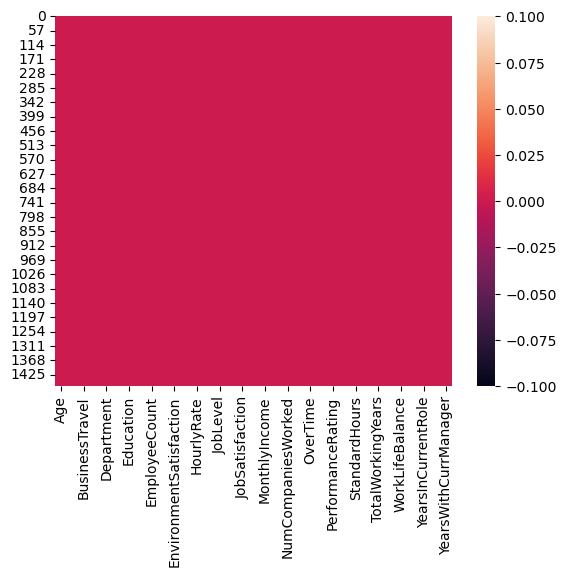

In [150]:
sns.heatmap(df.isnull())

In [151]:
#check the no. of columns

df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

In [152]:
# check uniqueness

df.nunique()

Age                           43
Attrition                      2
BusinessTravel                 3
DailyRate                    886
Department                     3
DistanceFromHome              29
Education                      5
EducationField                 6
EmployeeCount                  1
EmployeeNumber              1470
EnvironmentSatisfaction        4
Gender                         2
HourlyRate                    71
JobInvolvement                 4
JobLevel                       5
JobRole                        9
JobSatisfaction                4
MaritalStatus                  3
MonthlyIncome               1349
MonthlyRate                 1427
NumCompaniesWorked            10
Over18                         1
OverTime                       2
PercentSalaryHike             15
PerformanceRating              2
RelationshipSatisfaction       4
StandardHours                  1
StockOptionLevel               4
TotalWorkingYears             40
TrainingTimesLastYear          7
WorkLifeBa

The dataset has a variety of unique values across columns: most numerical columns (like Age, DistanceFromHome, and YearsAtCompany) have many unique values, while categorical columns (like Attrition, BusinessTravel, and Gender) have fewer distinct values. Some columns, such as EmployeeCount and StandardHours, have only one unique value, indicating they provide no variability.

In [153]:
# count Attrition
df["Attrition"].value_counts()

Attrition
No     1233
Yes     237
Name: count, dtype: int64

Out of 1470 employees, 1233 did not leave the company (Attrition = No), while 237 employees left (Attrition = Yes).

# Description

In [154]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


The dataset shows that employees are between 18 and 60 years old, with an average age of 37. Daily rates range from 102 to 1499, and the average distance from home is 7 miles. Education levels span 1 to 5, while hourly rates vary from $30 to $100. Most employees have worked at the company for around 5 years, with total work experience ranging from 0 to 40 years. Some columns, like EmployeeCount and StandardHours, have the same value for all entries, providing no meaningful information.

# Dropping column with one unique value

In [157]:
# Drop 
df = df.loc[:, df.nunique() > 1]

# Display the updated dataframe
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,...,3,1,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,2,3,...,4,4,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,4,...,3,2,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,5,4,...,3,3,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,7,1,...,3,4,1,6,3,3,2,2,2,2


In [158]:
# Separate numerical and categorical columns
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

print("Numerical Columns:", numerical_cols)
print("Categorical Columns:", categorical_cols)


Numerical Columns: Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel',
       'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')
Categorical Columns: Index(['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender',
       'JobRole', 'MaritalStatus', 'OverTime'],
      dtype='object')


# Visualization

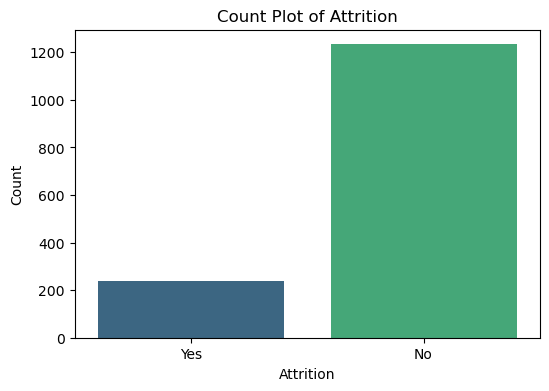

In [162]:
# Plot count plot for 'Attrition' column
plt.figure(figsize=(6, 4))
sns.countplot(x='Attrition', data=df, palette='viridis')
plt.title('Count Plot of Attrition')
plt.xlabel('Attrition')
plt.ylabel('Count')
plt.show()

Department
Research & Development    961
Sales                     446
Human Resources            63
Name: count, dtype: int64


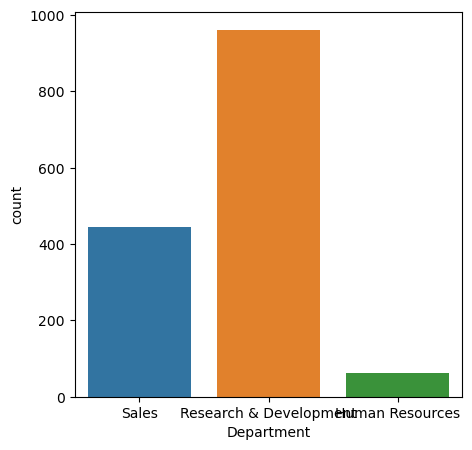

In [163]:
# Count of employees in each Department
print(df['Department'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='Department', data=df)
plt.show()

BusinessTravel
Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: count, dtype: int64


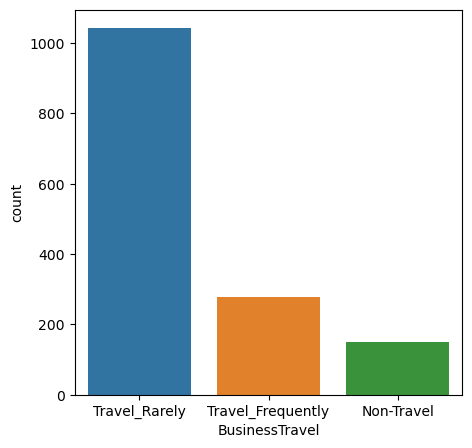

In [164]:
#Count of employees based on BusinessTravel
print(df['BusinessTravel'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='BusinessTravel', data=df)
plt.show()

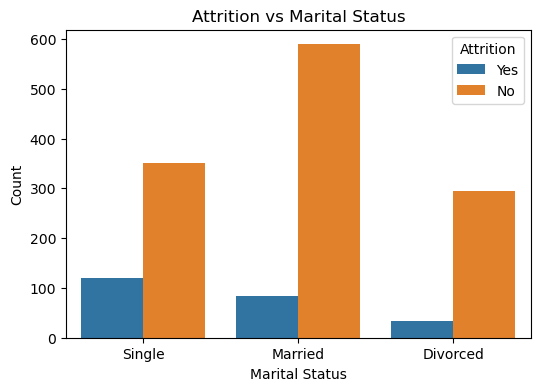

In [174]:
# Countplot for Attrition vs MaritalStatus
plt.figure(figsize=(6, 4))
sns.countplot(x='MaritalStatus', hue='Attrition', data=df)
plt.title('Attrition vs Marital Status')
plt.xlabel('Marital Status')
plt.ylabel('Count')
plt.show()

Gender
Male      882
Female    588
Name: count, dtype: int64


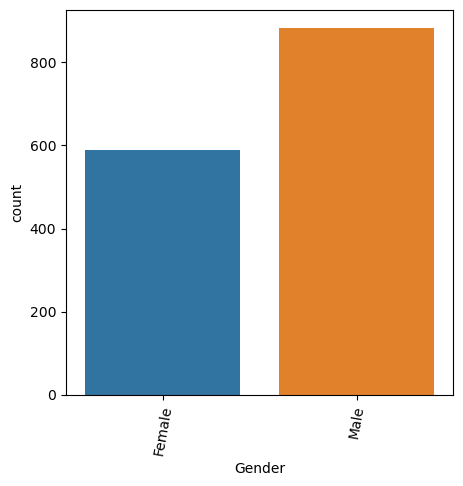

In [165]:
#Gender count of employees
print(df['Gender'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='Gender', data=df)
plt.xticks(rotation=80)
plt.show()

EducationField
Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: count, dtype: int64


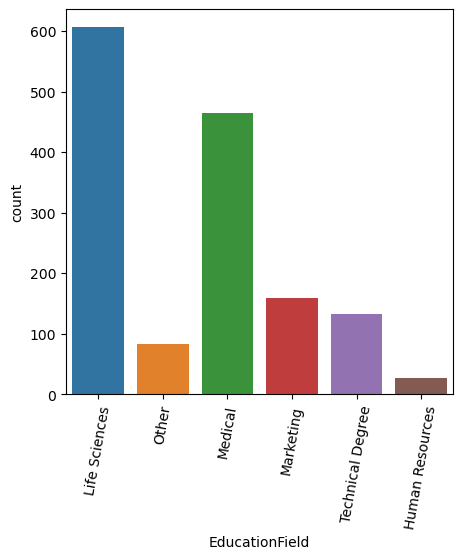

In [166]:
#Count of Educational Field of the employees
print(df['EducationField'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='EducationField', data=df)
plt.xticks(rotation=80)
plt.show()

JobRole
Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: count, dtype: int64


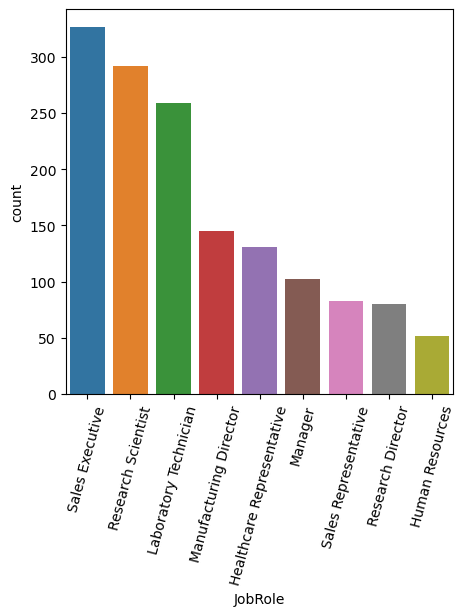

In [167]:
#Job Role of employees
print(df['JobRole'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='JobRole', data=df)
plt.xticks(rotation=75)
plt.show()

OverTime
No     1054
Yes     416
Name: count, dtype: int64


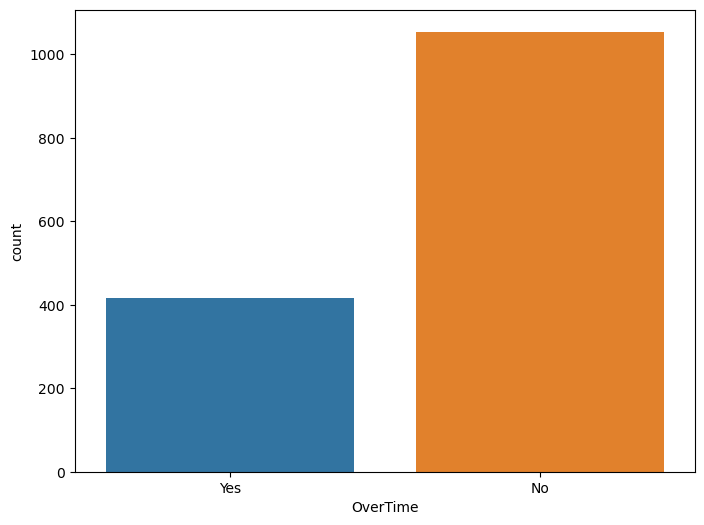

In [168]:
#Overtime data of employees
print(df['OverTime'].value_counts())
plt.figure(figsize=(8, 6))
sns.countplot(x='OverTime', data=df)
plt.show()

MaritalStatus
Married     673
Single      470
Divorced    327
Name: count, dtype: int64


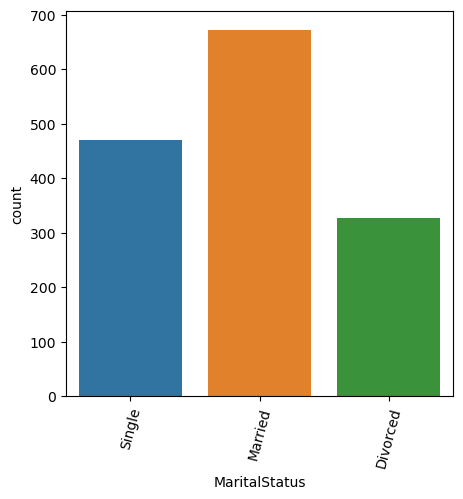

In [169]:
# Marital Status of employees
print(df['MaritalStatus'].value_counts())
plt.figure(figsize=(5, 5))
sns.countplot(x='MaritalStatus', data=df)
plt.xticks(rotation=75)
plt.show()

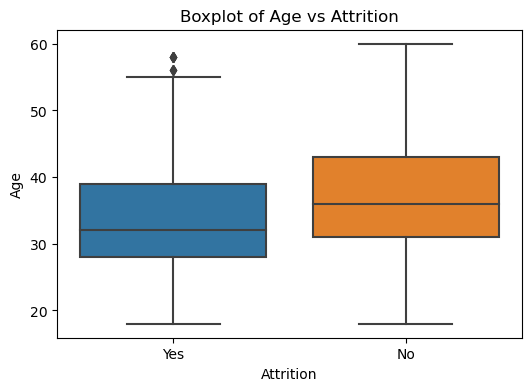

In [171]:
# Boxplot for Age vs Attrition
plt.figure(figsize=(6, 4))
sns.boxplot(x='Attrition', y='Age', data=df)
plt.title('Boxplot of Age vs Attrition')
plt.show()

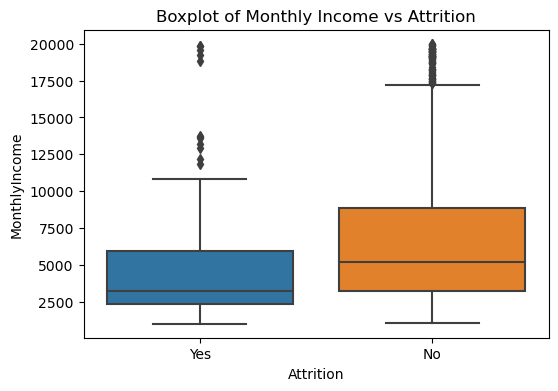

In [172]:
# Boxplot for MonthlyIncome vs Attrition
plt.figure(figsize=(6,4))
sns.boxplot(x='Attrition', y='MonthlyIncome', data=df)
plt.title('Boxplot of Monthly Income vs Attrition')
plt.show()

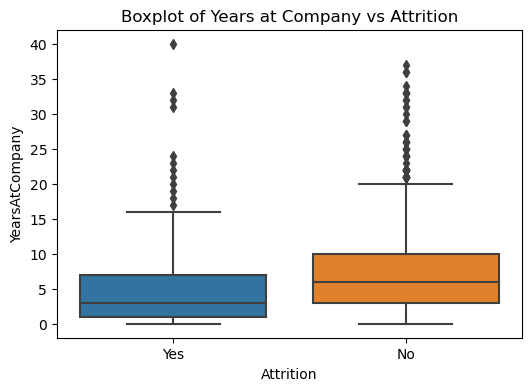

In [173]:
# Boxplot for YearsAtCompany vs Attrition
plt.figure(figsize=(6,4))
sns.boxplot(x='Attrition', y='YearsAtCompany', data=df)
plt.title('Boxplot of Years at Company vs Attrition')
plt.show()

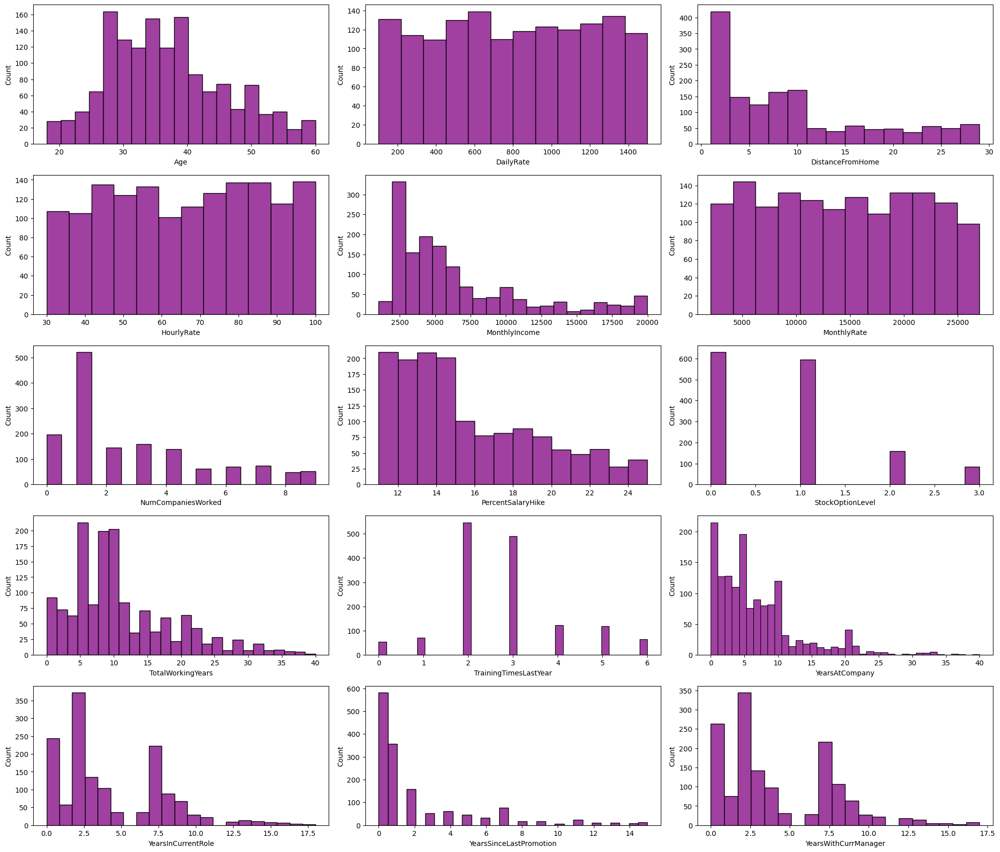

In [179]:
# List of numerical columns from the DataFrame
numerical_col = ['Age', 'DailyRate', 'DistanceFromHome', 'HourlyRate', 'MonthlyIncome', 
                 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'StockOptionLevel', 
                 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 
                 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

# Plotting distribution for each numerical column
plt.figure(figsize=(20, 20))
for i, column in enumerate(numerical_col, 1):
    plt.subplot(6, 3, i)
    sns.histplot(df[column], color='Purple')
    plt.xlabel(column)
plt.tight_layout()
plt.show()

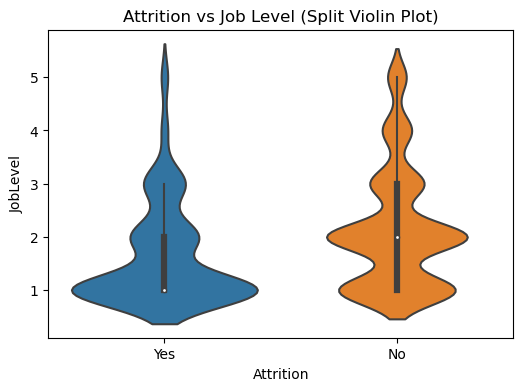

In [183]:
# Split Violin Plot for Attrition vs Job Level
plt.figure(figsize=(6, 4))
sns.violinplot(x='Attrition', y='JobLevel', data=df, split=True)

plt.title('Attrition vs Job Level (Split Violin Plot)')
plt.show()


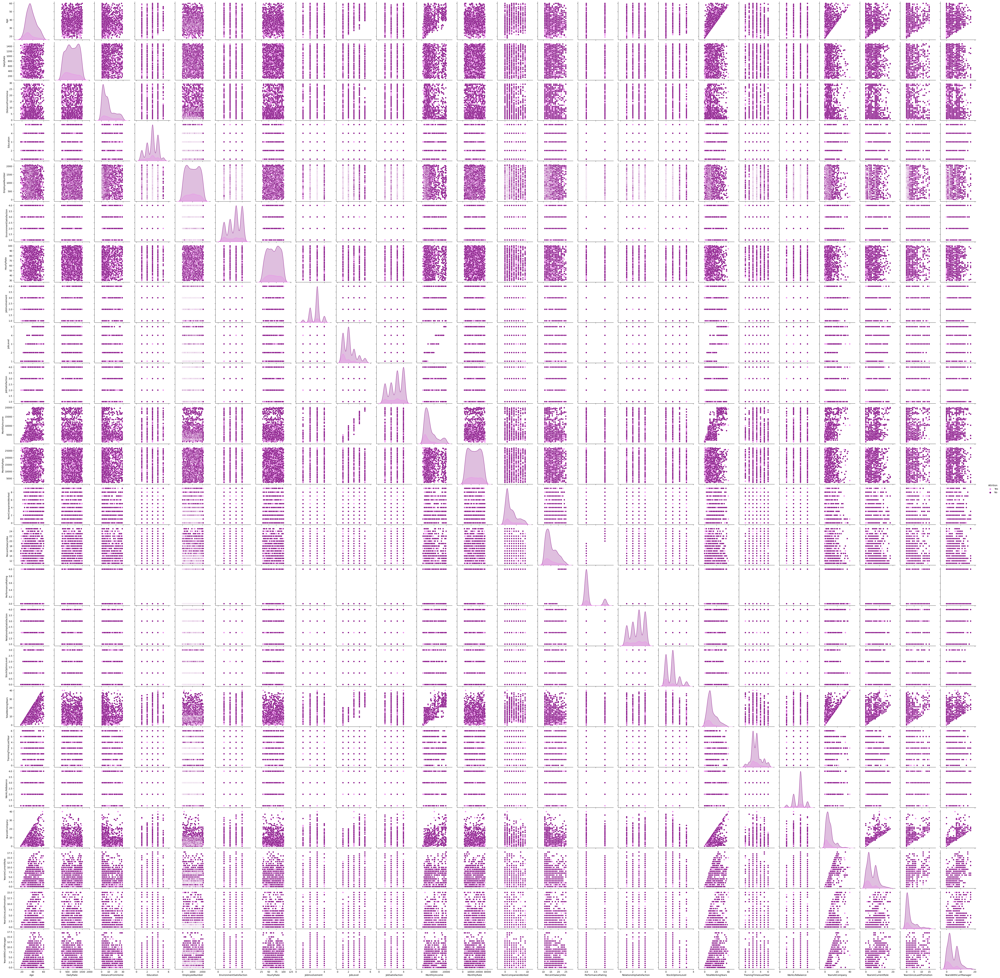

In [185]:
# Check the relation in the dataset.
sns.pairplot(df, hue='Attrition', palette={'No': 'purple', 'Yes': 'violet'})

plt.show()

# Remove ouliers

In [184]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement',
       'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'OverTime',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')

In [186]:
# List numerical columns
numerical_col = df.select_dtypes(include='number').columns.tolist()

print(numerical_col)


['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']


In [187]:
# Features with outliers
features = df[['MonthlyIncome','NumCompaniesWorked','PerformanceRating','StockOptionLevel','TotalWorkingYears','TrainingTimesLastYear','YearsAtCompany','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]

In [188]:
z = np.abs(zscore (features))
z

,MonthlyIncome,NumCompaniesWorked,PerformanceRating,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.108350,2.125136,0.426230,0.932014,0.421642,2.171982,0.164613,0.063296,0.679146,0.245834
1,0.291719,0.678049,2.346151,0.241988,0.164511,0.155707,0.488508,0.764998,0.368715,0.806541
2,0.937654,1.324226,0.426230,0.932014,0.550208,0.155707,1.144294,1.167687,0.679146,1.155935
3,0.763634,0.678049,0.426230,0.932014,0.421642,0.155707,0.161947,0.764998,0.252146,1.155935
4,0.644858,2.525591,0.426230,0.241988,0.678774,0.155707,0.817734,0.615492,0.058285,0.595227
...,...,...,...,...,...,...,...,...,...,...
1465,0.835451,0.523316,0.426230,0.241988,0.735447,0.155707,0.327893,0.615492,0.679146,0.314873
1466,0.741140,0.523316,0.426230,0.241988,0.293077,1.707500,0.001333,0.764998,0.368715,0.806541
1467,0.076690,0.678049,2.346151,0.241988,0.678774,2.171982,0.164613,0.615492,0.679146,0.314873
1468,0.236474,0.277594,0.426230,0.932014,0.735447,0.155707,0.325228,0.488900,0.679146,1.086895


In [189]:
# Making new DataFrame with Z score less than 3.

new_df = df[(z<3).all(axis = 1)] 
new_df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,...,3,1,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,2,3,...,4,4,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,4,4,...,3,2,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,5,4,...,3,3,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,7,1,...,3,4,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,2061,3,...,3,3,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,2062,4,...,3,1,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,2064,2,...,4,2,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,2065,4,...,3,4,0,17,3,2,9,6,0,8


In [190]:
# check new DataFrame shape.
new_df.shape

(1387, 32)

In [195]:
# Select  numeric columns
numerical_cols = new_df.select_dtypes(include=['number']).columns

# Calculate skewness only for numeric columns
skewness = new_df[numerical_cols].skew().sort_values()

print(skewness)

WorkLifeBalance            -0.557100
JobInvolvement             -0.501401
JobSatisfaction            -0.345612
EnvironmentSatisfaction    -0.325285
RelationshipSatisfaction   -0.295686
Education                  -0.289024
YearsWithCurrManager       -0.070570
YearsInCurrentRole         -0.069631
HourlyRate                 -0.030481
YearsAtCompany             -0.025230
DailyRate                  -0.017078
TotalWorkingYears          -0.009666
DistanceFromHome           -0.008149
NumCompaniesWorked          0.016175
EmployeeNumber              0.018931
MonthlyIncome               0.027700
MonthlyRate                 0.030596
TrainingTimesLastYear       0.057949
StockOptionLevel            0.089929
JobLevel                    0.110769
PercentSalaryHike           0.112128
Age                         0.472280
YearsSinceLastPromotion     1.756335
PerformanceRating           1.931566
dtype: float64


In [192]:
# Removing skewness.

skew = ['DistanceFromHome', 'JobLevel', 'MonthlyIncome', 'NumCompaniesWorked', 'PercentSalaryHike', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsWithCurrManager']
scaler = PowerTransformer(method='yeo-johnson')

In [193]:
new_df[skew] = scaler.fit_transform(new_df[skew].values)
new_df[skew].head()

,DistanceFromHome,JobLevel,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsInCurrentRole,YearsWithCurrManager
0,-1.489968,0.349828,0.386674,1.620671,-1.495549,-1.084263,-0.173231,-2.608524,0.231837,0.290524,0.582177
1,0.244561,0.349828,0.144235,-0.561880,1.690425,0.548653,0.147620,0.217074,0.948319,1.006575,1.018073
2,-1.028366,-1.141761,-1.431153,1.273711,0.193797,-1.084263,-0.351153,0.217074,-2.156089,-1.571814,-1.528426
3,-0.698191,-1.141761,-0.814425,-0.561880,-1.495549,-1.084263,-0.173231,0.217074,0.621429,1.006575,-1.528426
4,-1.028366,-1.141761,-0.504453,1.764103,-0.957525,0.548653,-0.544046,0.217074,-0.933983,-0.390769,-0.347871


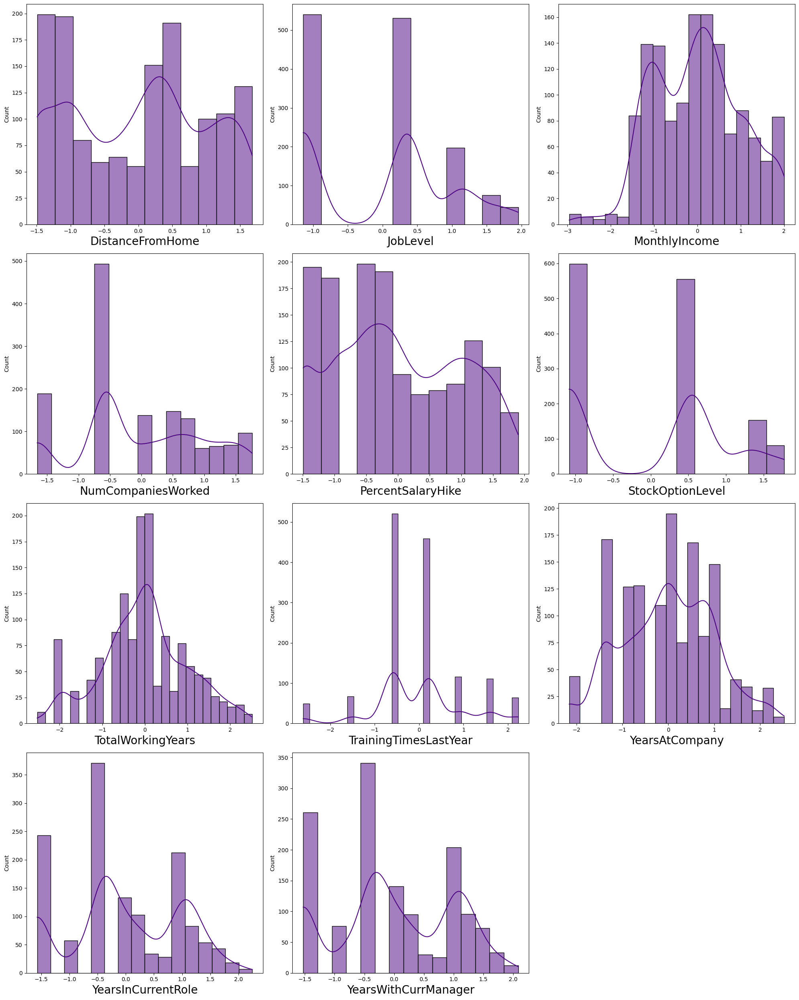

In [196]:
# Check data distribution after skewness removal
plt.figure(figsize=(20, 25), facecolor='white')

for i, column in enumerate(new_df[skew], 1):
    if i <= 12:
        plt.subplot(4, 3, i)
        sns.histplot(new_df[column], color='indigo', kde=True)
        plt.xlabel(column, fontsize=20)

plt.tight_layout()
plt.show()

# label encoding

In [197]:
categorical_col = ['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'OverTime']

In [198]:
LE = LabelEncoder()

new_df[categorical_col] =  new_df[categorical_col].apply(LE.fit_transform)

new_df[categorical_col]

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,OverTime
0,1,2,2,1,0,7,2,1
1,0,1,1,1,1,6,1,0
2,1,2,1,4,1,2,2,1
3,0,1,1,1,0,6,1,1
4,0,2,1,3,1,2,1,0
...,...,...,...,...,...,...,...,...
1465,0,1,1,3,1,2,1,0
1466,0,2,1,3,1,0,1,0
1467,0,2,1,1,1,4,1,1
1468,0,1,2,3,1,7,1,0


# Correlation between features and the target

In [199]:
corr = new_df.corr()
corr

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159366,0.022340,0.021946,-0.038242,-0.028793,0.198502,-0.032676,-0.002704,0.014098,...,-0.000617,0.041744,0.077833,0.634884,-0.013707,-0.016913,0.174149,0.118454,0.103632,0.114962
Attrition,-0.159366,1.000000,-0.001041,-0.057220,0.063637,0.080979,-0.032703,0.023585,-0.010169,-0.112393,...,0.010781,-0.052344,-0.175081,-0.220878,-0.059071,-0.062492,-0.201954,-0.187047,-0.029263,-0.186821
BusinessTravel,0.022340,-0.001041,1.000000,-0.004606,-0.003521,-0.015034,-0.010560,0.022576,-0.013273,0.001183,...,-0.018274,-0.029660,-0.012732,0.031888,0.011688,-0.014140,-0.021107,-0.032472,-0.027283,-0.033222
DailyRate,0.021946,-0.057220,-0.004606,1.000000,-0.005398,-0.003967,-0.018442,0.040645,-0.044886,0.033123,...,0.000574,0.004516,0.047773,0.043307,0.006581,-0.044266,0.005806,0.020542,-0.043870,0.007098
Department,-0.038242,0.063637,-0.003521,-0.005398,1.000000,0.037660,0.012846,0.013432,-0.007828,-0.014540,...,-0.039364,-0.037705,-0.001271,-0.007789,0.039412,0.026978,0.026334,0.057983,0.048931,0.023995
DistanceFromHome,-0.028793,0.080979,-0.015034,-0.003967,0.037660,1.000000,0.003595,0.011891,0.034843,-0.012075,...,0.013212,0.010099,0.027082,-0.012129,-0.015334,-0.027681,0.006570,0.013091,-0.003226,-0.002310
Education,0.198502,-0.032703,-0.010560,-0.018442,0.012846,0.003595,1.000000,-0.038017,0.042707,-0.026223,...,-0.023487,-0.002393,0.026805,0.152263,-0.023484,0.007844,0.038266,0.050563,0.042517,0.026340
EducationField,-0.032676,0.023585,0.022576,0.040645,0.013432,0.011891,-0.038017,1.000000,0.000058,0.047924,...,-0.003621,-0.013734,-0.017331,-0.008101,0.048844,0.034038,0.002739,0.002909,0.034094,0.025918
EmployeeNumber,-0.002704,-0.010169,-0.013273,-0.044886,-0.007828,0.034843,0.042707,0.000058,1.000000,0.011003,...,-0.027355,-0.063017,0.055292,-0.003381,0.019978,0.006280,0.017546,0.004207,-0.003801,0.000228
EnvironmentSatisfaction,0.014098,-0.112393,0.001183,0.033123,-0.014540,-0.012075,-0.026223,0.047924,0.011003,1.000000,...,-0.025299,0.018414,0.025227,-0.014091,-0.016757,0.032492,0.014305,0.031007,0.027943,0.007643


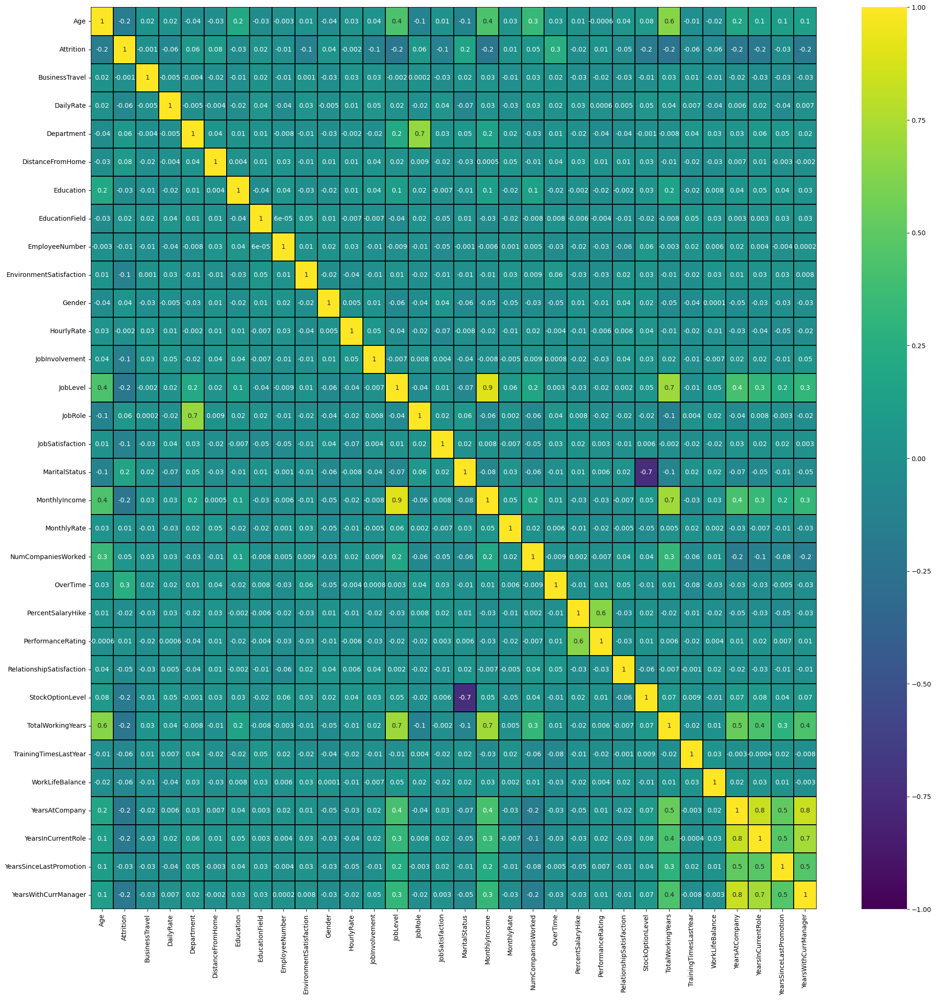

In [200]:
# Plot heatmap 
plt.figure(figsize=(25, 25))

sns.heatmap(new_df.corr(), 
            linewidths=0.1, 
            vmin=-1, 
            vmax=1, 
            fmt='.1g', 
            annot=True, 
            linecolor='black', 
            annot_kws={'size': 10}, 
            cmap='viridis')  

plt.yticks(rotation=0)
plt.show()

In [201]:
corr['Attrition'].sort_values(ascending = False)

Attrition                   1.000000
OverTime                    0.257237
MaritalStatus               0.160960
DistanceFromHome            0.080979
JobRole                     0.064283
Department                  0.063637
NumCompaniesWorked          0.047508
Gender                      0.036252
EducationField              0.023585
MonthlyRate                 0.014888
PerformanceRating           0.010781
BusinessTravel             -0.001041
HourlyRate                 -0.001532
EmployeeNumber             -0.010169
PercentSalaryHike          -0.017523
YearsSinceLastPromotion    -0.029263
Education                  -0.032703
RelationshipSatisfaction   -0.052344
DailyRate                  -0.057220
TrainingTimesLastYear      -0.059071
WorkLifeBalance            -0.062492
EnvironmentSatisfaction    -0.112393
JobSatisfaction            -0.114206
JobInvolvement             -0.133957
Age                        -0.159366
StockOptionLevel           -0.175081
YearsWithCurrManager       -0.186821
Y

# Corelation in label and features

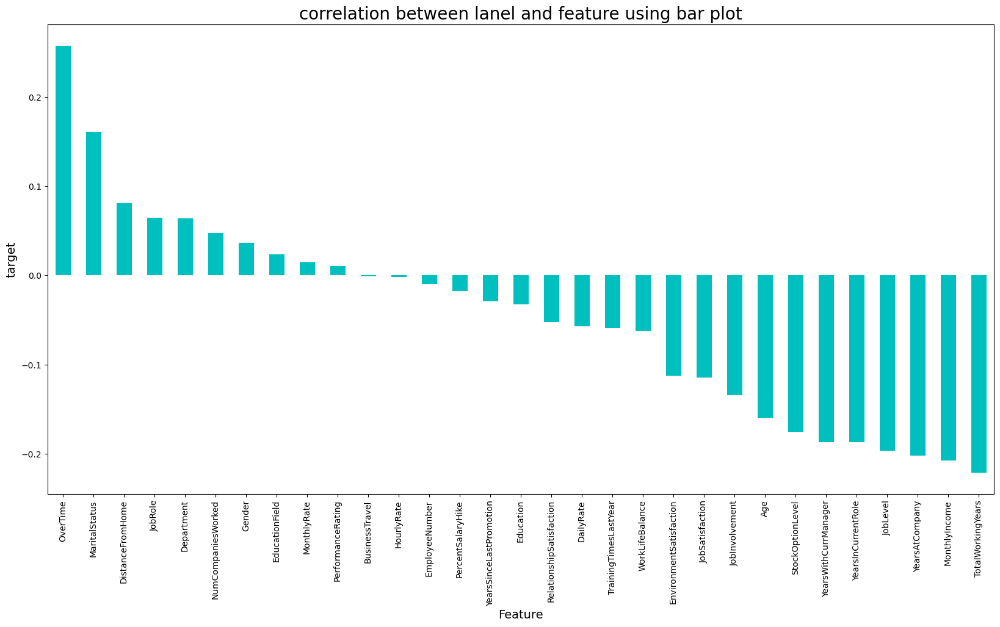

In [202]:
plt.figure(figsize = (20, 10))

new_df.corr()['Attrition'].sort_values(ascending = False).drop(['Attrition']).plot(kind = 'bar', color = 'c')

plt.xlabel('Feature', fontsize = 14)
plt.ylabel('target', fontsize = 14)
plt.title('correlation between lanel and feature using bar plot', fontsize = 20)

plt.show()

In [203]:
new_df.drop('BusinessTravel', axis = 1, inplace = True)
new_df.drop('HourlyRate', axis = 1, inplace = True)

In [204]:
new_df.head()

,Age,Attrition,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,1102,2,-1.489968,2,1,1,2,0,...,3,1,-1.084263,-0.173231,-2.608524,1,0.231837,0.290524,0,0.582177
1,49,0,279,1,0.244561,1,1,2,3,1,...,4,4,0.548653,0.147620,0.217074,3,0.948319,1.006575,1,1.018073
2,37,1,1373,1,-1.028366,2,4,4,4,1,...,3,2,-1.084263,-0.351153,0.217074,3,-2.156089,-1.571814,0,-1.528426
3,33,0,1392,1,-0.698191,4,1,5,4,0,...,3,3,-1.084263,-0.173231,0.217074,3,0.621429,1.006575,3,-1.528426
4,27,0,591,1,-1.028366,1,3,7,1,1,...,3,4,0.548653,-0.544046,0.217074,3,-0.933983,-0.390769,2,-0.347871


# Seperating features and label in x & y

In [205]:
x = new_df.drop('Attrition', axis = 1)

y = new_df['Attrition']

In [206]:
print(x.shape)

print(y.shape)

(1387, 29)
(1387,)


In [207]:
y.value_counts()

Attrition
0    1158
1     229
Name: count, dtype: int64

# Oversampling

In [209]:
SM = SMOTE()

x, y = SM.fit_resample(x, y)

In [210]:
y.value_counts()

Attrition
1    1158
0    1158
Name: count, dtype: int64

# Feature Scaling using Standard Scalarization

In [211]:
scaler = StandardScaler()

x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)

x

,Age,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,Gender,JobInvolvement,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,0.716784,0.833632,1.593430,-1.645132,-0.753049,-0.912678,-1.775666,-0.419440,-1.024479,0.656010,...,-0.342376,-1.427269,-0.969618,0.031907,-2.720926,-2.154559,0.440788,0.498748,-0.677089,0.795690
1,1.645755,-1.318998,-0.362258,0.193501,-1.782601,-0.912678,-1.773921,0.503966,0.976106,-0.690904,...,2.920764,1.425627,0.756979,0.362118,0.289142,0.546366,1.189494,1.261402,-0.240403,1.254362
2,0.252298,1.542457,-0.362258,-1.155825,-0.753049,1.492058,-1.770431,1.427371,0.976106,-0.690904,...,-0.342376,-0.476304,-0.969618,-0.151205,0.289142,0.546366,-2.054534,-1.484797,-0.677089,-1.425191
3,-0.212187,1.592153,-0.362258,-0.805833,1.306055,-0.912678,-1.768687,1.427371,-1.024479,0.656010,...,-0.342376,0.474661,-0.969618,0.031907,0.289142,0.546366,0.847902,1.261402,0.632968,-1.425191
4,-0.908915,-0.502934,-0.362258,-1.155825,-1.782601,0.690479,-1.765197,-1.342845,0.976106,0.656010,...,-0.342376,1.425627,0.756979,-0.349725,0.289142,0.546366,-0.777464,-0.226886,0.196282,-0.182952
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2311,0.020056,1.139656,-0.362258,1.672001,-1.782601,-0.111100,-1.374367,-1.342845,0.976106,-0.690904,...,-0.342376,-0.476304,-0.969618,0.592498,-0.559942,-0.804097,-1.284987,-1.484797,-0.677089,-1.260133
2312,1.529633,-0.291071,-0.362258,0.253899,-0.753049,-0.111100,0.270959,-1.342845,-1.024479,-0.690904,...,-0.342376,1.425627,0.756979,-0.099861,-0.289122,-0.804097,0.400247,0.385488,-0.677089,0.087329
2313,0.368420,1.785707,-0.362258,1.392261,0.276503,-0.912678,-0.044846,-0.419440,-1.024479,0.656010,...,-0.342376,0.474661,-0.969618,1.494688,-0.306858,-0.804097,-1.284987,-1.484797,-0.677089,-1.425191
2314,-0.908915,-1.052208,-0.362258,-0.678908,-0.753049,-0.912678,-0.196642,-1.342845,0.976106,-0.690904,...,-0.342376,-1.427269,0.438263,-0.279279,-0.738946,0.546366,-0.554368,-0.459087,-0.677089,-0.274992


In [212]:
# VIF value check

vif = pd.DataFrame()

vif['VIF val'] = [variance_inflation_factor(x.values,i)
              for i in range(len(x.columns))]
vif['Features'] = x.columns

vif

,VIF val,Features
0,1.957323,Age
1,1.048329,DailyRate
2,2.004907,Department
3,1.040757,DistanceFromHome
4,1.079458,Education
5,1.048334,EducationField
6,1.048921,EmployeeNumber
7,1.079931,EnvironmentSatisfaction
8,1.064723,Gender
9,1.105595,JobInvolvement


# model training

In [213]:
maxAccu = 0
maxRS = 0
for i in range(1, 200):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = i)
    DTC = DecisionTreeClassifier()
    DTC.fit(x_train, y_train)
    pred = DTC.predict(x_test)
    acc = accuracy_score(y_test, pred)
    if acc > maxAccu:
        maxAccu = acc
        maxRS = i
print('Best accuracy is ', maxAccu,' on Random_state ', maxRS)

Best accuracy is  0.883453237410072  on Random_state  47


hence we get best accuracy 88%

In [214]:
# Create test train split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = 131)

# Logistic regressor

In [215]:
# Checking accuracy for Logistic Regression Classifier

LR = LogisticRegression()
LR.fit(x_train, y_train)

predLR = LR.predict(x_test)

print(accuracy_score(y_test, predLR))
print(confusion_matrix(y_test, predLR))
print(classification_report(y_test, predLR))

0.837410071942446
[[271  56]
 [ 57 311]]
              precision    recall  f1-score   support

           0       0.83      0.83      0.83       327
           1       0.85      0.85      0.85       368

    accuracy                           0.84       695
   macro avg       0.84      0.84      0.84       695
weighted avg       0.84      0.84      0.84       695



# Decision Tree classifier

In [216]:
# Decision Tree Classifier Accuracy

DTC = DecisionTreeClassifier()
DTC.fit(x_train, y_train)

predDTC = DTC.predict(x_test)

print(accuracy_score(y_test, predDTC))
print(confusion_matrix(y_test, predDTC))
print(classification_report(y_test, predDTC))

0.8330935251798561
[[262  65]
 [ 51 317]]
              precision    recall  f1-score   support

           0       0.84      0.80      0.82       327
           1       0.83      0.86      0.85       368

    accuracy                           0.83       695
   macro avg       0.83      0.83      0.83       695
weighted avg       0.83      0.83      0.83       695



# Random forest classifier

In [219]:
# Accuracy for Random Forest Classifier

RFC = RandomForestClassifier()
RFC.fit(x_train, y_train)

predRFC = RFC.predict(x_test)

print(accuracy_score(y_test, predRFC))
print(confusion_matrix(y_test, predRFC))
print(classification_report(y_test, predRFC))

0.9179856115107914
[[311  16]
 [ 41 327]]
              precision    recall  f1-score   support

           0       0.88      0.95      0.92       327
           1       0.95      0.89      0.92       368

    accuracy                           0.92       695
   macro avg       0.92      0.92      0.92       695
weighted avg       0.92      0.92      0.92       695



# Hyperparameter tunning

In [220]:
parameters = {'n_estimators' : [50],
             'criterion' : ['gini'],
             'max_depth' : [2, 4, 6]}

In [221]:
GCV = GridSearchCV(RFC, parameters, cv = 5)

In [222]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini'], 'max_depth': [2, 4, 6],
                         'n_estimators': [50]})

In [223]:
GCV.best_params_

{'criterion': 'gini', 'max_depth': 6, 'n_estimators': 50}

In [224]:
Attrition = RandomForestClassifier(criterion = 'gini', max_depth = 6, n_estimators = 100)

Attrition.fit(x_train, y_train)

pred = Attrition.predict(x_test)

print(accuracy_score(y_test, predRFC))

print('RMSE value:', np.sqrt(metrics.mean_squared_error(y_test, pred)))

print('R2_Score:', r2_score(y_test, pred) * 50)

0.9179856115107914
RMSE value: 0.34971725475501103
R2_Score: 25.45414506049728


In [225]:
import joblib

# Assuming 'RFC' is the model you want to save
joblib.dump(RFC, 'HR_analytics_For_the_Attrition_in_HR.pkl')


['HR_analytics_For_the_Attrition_in_HR.pkl']